## Global Runoff Data Center streamflow data

#### The main objective of this script is to export the time-series of each country that will use the GRDC database.

The data was already pre-processed and pre-filtered in previous codes (i.e., D_04_DataAnalyis_GRDC_Reading_and_Filtering_part-I and D_04_DataAnalyis_GRDC_Gap_Analysis_part-II)

#### The countries that will be used are: Germany (DE), Iceland (IS), Poland (PL), Latvia (LV), Estonia (EE), Lithuania (LT), Romania (RO), Slovakia (SK), Belarus (BY) and Russia (RU):

Written by: Thiago Victor Medeiros do Nascimento

References:

1. Global Runoff Data Center: https://www.bafg.de/GRDC/EN/Home/homepage_node.html

First we import some useful modules:

In [1]:
import geopandas as gpd                                      # Pandas for geospatial analysis
from shapely.geometry import Point, Polygon                  # Module used for geospatial analysis     
import pymannkendall as mk                                   # Module used for trend-computation
from plotly.offline import plot
import contextily as cx
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.axes_grid1 import make_axes_locatable
import warnings                                              
import datetime                                              # Datetime module pretty useful for time-series analysis
import tqdm as tqdm                                          # Useful module to access the progress bar of a loop
import os
import glob
warnings.simplefilter(action='ignore', category=Warning)     # Module useful for taking out some unecessary warnings


%config Completer.use_jedi = False                           # This improve the auto-fill function

import geospatialfunctions as geospatialfunctions            # Geospatialfunctions is a module with useful functions

First we should set our directory:

In [2]:
path = r"C:\Users\nascimth\Documents\Thiago\Eawag\Python\Datasets"
os.chdir(path)
os.getcwd()

'C:\\Users\\nascimth\\Documents\\Thiago\\Eawag\\Python\\Datasets'

Here we can import the full GRDC time-series and the pre-processed network information:

In [3]:
#First we read our data:
timeseriesfinal = pd.read_csv(r'GRDC\timeseries\timeseries_grdc.csv', encoding='latin-1', engine='python', delimiter = ",",
                             index_col = 0)

timeseriesfinal

,6111100,6112070,6112080,6112090,6112100,6113050,6113100,6113110,6114100,6114150,...,6984500,6984700,6984800,6986100,6987050,6987100,6987150,6998200,6998300,6998400
1900-09-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The date.index was not set as datetime after the read, so we should set it in order to acheive all the capabilities of the other functions. 

In [4]:
timeseriesfinal.index = pd.to_datetime(timeseriesfinal.index)
type(timeseriesfinal.index)

pandas.core.indexes.datetimes.DatetimeIndex

We do need to convert the columns to int, otherwise we will not be able to make some compatiblization with the other dataset.

In [5]:
timeseriesfinal.columns = timeseriesfinal.columns.astype(int)

Here we can import the GRDC network information regarding the filtered stations:

In [6]:
network_cond_2 = pd.read_csv(r'GRDC\timeseries\network_grdc.csv', encoding='latin-1', engine='python', delimiter = ",",
                             index_col = 0)
network_cond_2

,grdc_no,wmo_reg,sub_reg,river,station,country,lat,long,area,altitude,...,m_start,m_end,m_yrs,m_miss,t_start,t_end,t_yrs,lta_discharge,r_volume_yr,r_height_yr
7753,6118130,6,6180,ABER VRAC'H,DRENNEC,FR,48.530410,-4.362693,24.0,90.60,...,NaN,NaN,NaN,NaN,1966,2012,47,0.448,0.014128128,588.672
7754,6118150,6,6180,GUILLEC,TREZILIDE,FR,48.615037,-4.077011,43.0,91.10,...,NaN,NaN,NaN,NaN,1966,2012,47,0.682,0.021507552,500.1756279069768
7755,6118160,6,6180,PENZE,TAULE (PENHOAT),FR,48.584822,-3.924127,141.0,61.97,...,NaN,NaN,NaN,NaN,1967,2012,46,2.813,0.08871076800000001,629.1543829787234
7756,6118165,6,6180,RISLE,RAI,FR,48.747942,0.580580,149.0,255.45,...,NaN,NaN,NaN,NaN,1965,2012,48,1.379,0.043488144,291.8667382550336
7757,6118175,6,6180,JARLOT,PLOUGONVEN,FR,48.565562,-3.800485,44.0,73.86,...,NaN,NaN,NaN,NaN,1966,2012,47,0.712,0.022453632,510.3098181818181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10607,6971130,6,6712,TULOMA,VERKHNE-TULOMSKIY GES,RU,68.600000,31.750000,17500.0,-999.00,...,1934.0,2017.0,84.0,25.349301,1934,2017,84,193.903,6.114925008,349.4242861714285
10643,6971600,6,6713,VARZUGA,VARZUGA,RU,66.400000,36.300000,7940.0,9.00,...,1935.0,1992.0,58.0,0.288600,1935,2011,77,91.75,2.893428,364.4115869017632
10673,6977100,6,6771,VOLGA,VOLGOGRAD POWER PLANT,RU,48.804722,44.585833,1360000.0,-999.00,...,1879.0,1984.0,106.0,17.924528,1879,2010,132,7827.676,246.853590336,181.5099928941177
10676,6978250,6,6781,DON,RAZDORSKAYA,RU,47.540833,40.647222,378000.0,58.00,...,1881.0,1984.0,104.0,3.453815,1881,2010,130,681.961,21.506322096,56.895032


In [7]:
# Here we can create a list with the stations names (in case we deleted another station):
stations_used = network_cond_2.grdc_no.tolist()

In [8]:
# Finally we create a time-series with only the stations used:
timeseriesfinal_used = timeseriesfinal.loc[:, stations_used]

timeseriesfinal_used

,6118130,6118150,6118160,6118165,6118175,6118185,6118195,6118205,6118230,6119010,...,6970100,6970250,6970500,6970700,6970869,6971130,6971600,6977100,6978250,6983350
1900-09-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1900-09-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Now we can start analying our gaps so we have them all computed already before exporting each time-series:

In [9]:
# This auxiliar dataframe is used to better plot our dataset:
coords = network_cond_2[["long", "lat", "grdc_no"]]
coords.set_index('grdc_no', inplace = True)
coords

,long,lat
grdc_no,,
6118130,-4.362693,48.530410
6118150,-4.077011,48.615037
6118160,-3.924127,48.584822
6118165,0.580580,48.747942
6118175,-3.800485,48.565562
...,...,...
6971130,31.750000,68.600000
6971600,36.300000,66.400000
6977100,44.585833,48.804722


In [10]:
summarygapsstations = geospatialfunctions.summarygaps(timeseriesfinal_used.loc["1981":"2018",:], coords)
summarygapsstations

,CoordX,CoordY,NumGaps,PercentageGaps
Code,,,,
6118130,-4.362693,48.530410,2412.0,17.378774
6118150,-4.077011,48.615037,2399.0,17.285107
6118160,-3.924127,48.584822,2408.0,17.349953
6118165,0.580580,48.747942,3486.0,25.117083
6118175,-3.800485,48.565562,2578.0,18.574825
...,...,...,...,...
6971130,31.750000,68.600000,2558.0,18.430723
6971600,36.300000,66.400000,2922.0,21.053390
6977100,44.585833,48.804722,3287.0,23.683262


Here we can plot the gaps:

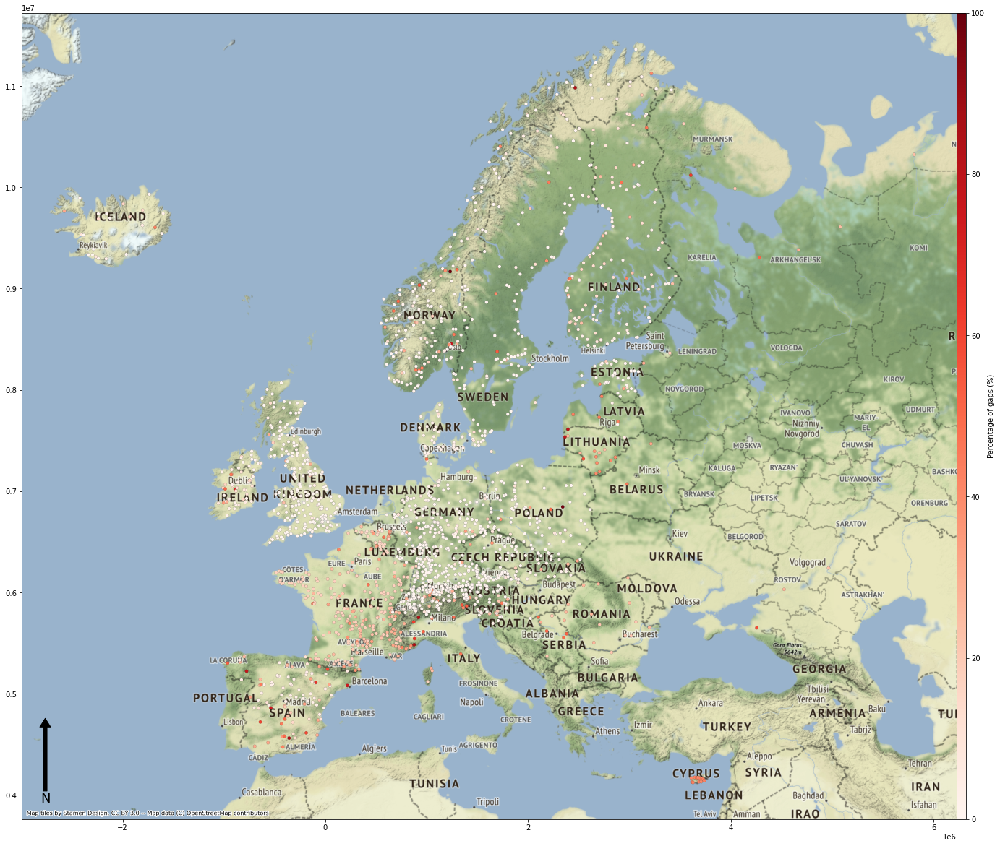

In [11]:
figplot, axesplot = geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations, crsproj = 'epsg:4326', backmapproj = True, 
                                       figsizeproj = (23.4, 23.4), cmapproj = "Reds", legend_title = "Percentage of gaps (%)",
                                       legend_orientation = "vertical", pad_map = 0, markersize_map = 20,
                                       north_arrow = True, 
                                       set_map_limits = False, minx = -25, miny = 35, maxx = 30, maxy = 72)

#plot.savefig('world.jpg', bbox_inches='tight', dpi=300)

(<Figure size 1080x2160 with 1 Axes>, <AxesSubplot:>)

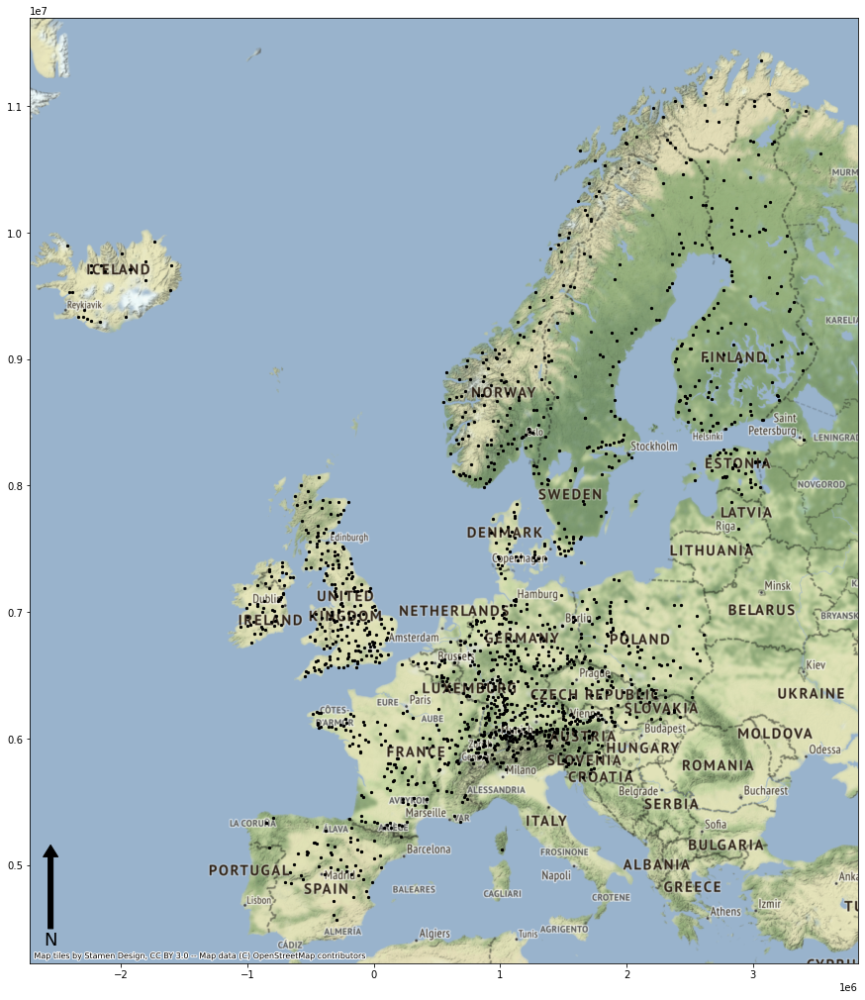

In [12]:
geospatialfunctions.plotpointsmap(summarygapsstations[summarygapsstations.PercentageGaps < 20.0], showcodes = False,  
                                  backmapproj = True,
                                  markersize_map = 5, 
                                  north_arrow = True, 
                                  set_map_limits = True,
                                  minx = -25, miny = 35, maxx = 30, maxy = 72)

Here we set the grdc number as the index:

In [13]:
network_cond_3 = network_cond_2.set_index("grdc_no")
network_cond_3

,wmo_reg,sub_reg,river,station,country,lat,long,area,altitude,d_start,...,m_start,m_end,m_yrs,m_miss,t_start,t_end,t_yrs,lta_discharge,r_volume_yr,r_height_yr
grdc_no,,,,,,,,,,,,,,,,,,,,,
6118130,6,6180,ABER VRAC'H,DRENNEC,FR,48.530410,-4.362693,24.0,90.60,1966-01-01,...,NaN,NaN,NaN,NaN,1966,2012,47,0.448,0.014128128,588.672
6118150,6,6180,GUILLEC,TREZILIDE,FR,48.615037,-4.077011,43.0,91.10,1966-01-01,...,NaN,NaN,NaN,NaN,1966,2012,47,0.682,0.021507552,500.1756279069768
6118160,6,6180,PENZE,TAULE (PENHOAT),FR,48.584822,-3.924127,141.0,61.97,1967-01-01,...,NaN,NaN,NaN,NaN,1967,2012,46,2.813,0.08871076800000001,629.1543829787234
6118165,6,6180,RISLE,RAI,FR,48.747942,0.580580,149.0,255.45,1965-01-01,...,NaN,NaN,NaN,NaN,1965,2012,48,1.379,0.043488144,291.8667382550336
6118175,6,6180,JARLOT,PLOUGONVEN,FR,48.565562,-3.800485,44.0,73.86,1966-01-01,...,NaN,NaN,NaN,NaN,1966,2012,47,0.712,0.022453632,510.3098181818181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6971130,6,6712,TULOMA,VERKHNE-TULOMSKIY GES,RU,68.600000,31.750000,17500.0,-999.00,1935-01-01,...,1934.0,2017.0,84.0,25.349301,1934,2017,84,193.903,6.114925008,349.4242861714285
6971600,6,6713,VARZUGA,VARZUGA,RU,66.400000,36.300000,7940.0,9.00,1979-01-01,...,1935.0,1992.0,58.0,0.288600,1935,2011,77,91.75,2.893428,364.4115869017632
6977100,6,6771,VOLGA,VOLGOGRAD POWER PLANT,RU,48.804722,44.585833,1360000.0,-999.00,1962-01-01,...,1879.0,1984.0,106.0,17.924528,1879,2010,132,7827.676,246.853590336,181.5099928941177


In [14]:
summarygapsstations["Country"] = network_cond_3.country
summarygapsstations["area"] = network_cond_3.area
summarygapsstations["elevation"] = network_cond_3.altitude
summarygapsstations["sub_reg"] = network_cond_3.sub_reg
summarygapsstations["river"] = network_cond_3.river
summarygapsstations["station"] = network_cond_3.station


summarygapsstations["d_start"] = pd.to_datetime(network_cond_3.d_start)
summarygapsstations["d_end"] = pd.to_datetime(network_cond_3.d_end)





# It is also improtant to replace any -999 data to NaN:
summarygapsstations.replace(-999.0, np.nan, inplace=True)
summarygapsstations["area"].replace(0, np.nan, inplace=True)

summarygapsstations

,CoordX,CoordY,NumGaps,PercentageGaps,geometry,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,,
6118130,-4.362693,48.530410,2412.0,17.378774,POINT (-4.36269 48.53041),FR,24.0,90.60,6180,ABER VRAC'H,DRENNEC,1966-01-01,2012-01-01
6118150,-4.077011,48.615037,2399.0,17.285107,POINT (-4.07701 48.61504),FR,43.0,91.10,6180,GUILLEC,TREZILIDE,1966-01-01,2012-01-01
6118160,-3.924127,48.584822,2408.0,17.349953,POINT (-3.92413 48.58482),FR,141.0,61.97,6180,PENZE,TAULE (PENHOAT),1967-01-01,2012-01-01
6118165,0.580580,48.747942,3486.0,25.117083,POINT (0.58058 48.74794),FR,149.0,255.45,6180,RISLE,RAI,1965-01-01,2012-01-01
6118175,-3.800485,48.565562,2578.0,18.574825,POINT (-3.80049 48.56556),FR,44.0,73.86,6180,JARLOT,PLOUGONVEN,1966-01-01,2012-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6971130,31.750000,68.600000,2558.0,18.430723,POINT (31.75000 68.60000),RU,17500.0,NaN,6712,TULOMA,VERKHNE-TULOMSKIY GES,1935-01-01,2011-01-01
6971600,36.300000,66.400000,2922.0,21.053390,POINT (36.30000 66.40000),RU,7940.0,9.00,6713,VARZUGA,VARZUGA,1979-01-01,2011-01-01
6977100,44.585833,48.804722,3287.0,23.683262,POINT (44.58583 48.80472),RU,1360000.0,NaN,6771,VOLGA,VOLGOGRAD POWER PLANT,1962-01-01,2010-01-01


Here we can plot our dataset with the circles proportional to their respective catchment area:

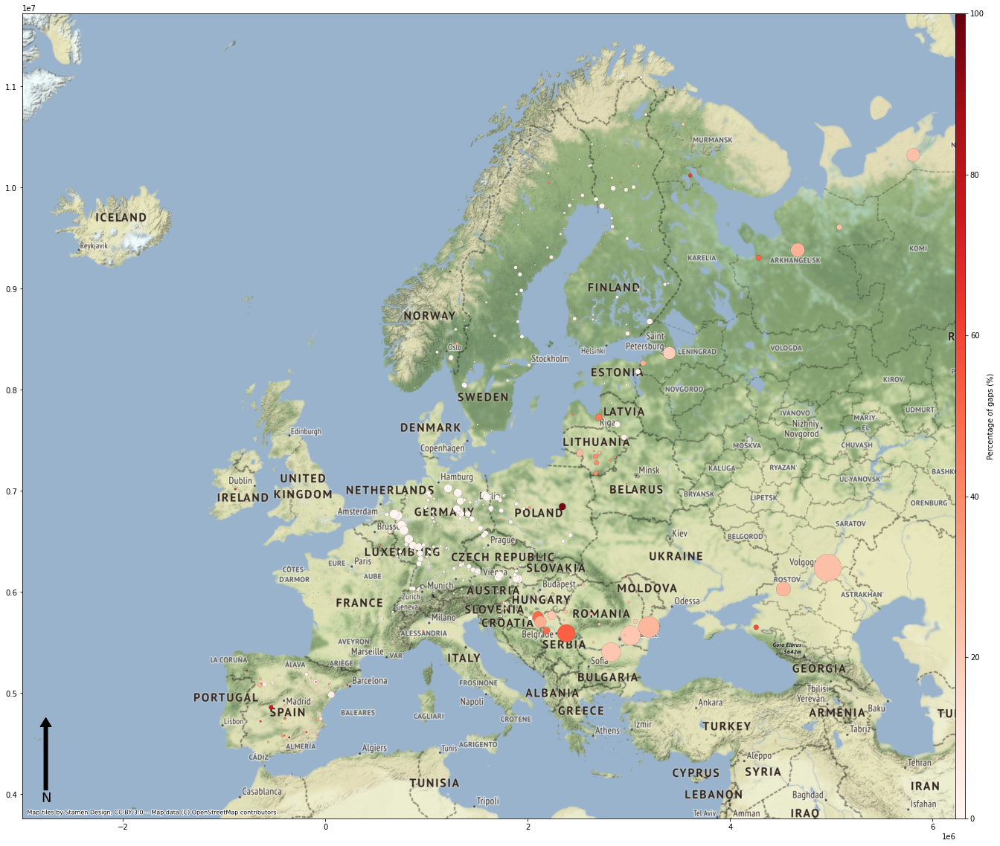

In [15]:
figplot, axesplot = geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations,
                                       crsproj = 'epsg:4326', backmapproj = True, 
                                       figsizeproj = (22.7, 22.7), cmapproj = "Reds", legend_title = "Percentage of gaps (%)",
                                       legend_orientation = "vertical", pad_map = 0, linewidth_marker = 0.1,
                                       markersize_map = summarygapsstations['area']/1000,
                                       north_arrow = True, 
                                       set_map_limits = False, minx = -11, miny = 50, maxx = -6, maxy = 56)

#plot.savefig('world.jpg', bbox_inches='tight', dpi=300)

In [16]:
summarygapsstations

,CoordX,CoordY,NumGaps,PercentageGaps,geometry,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,,
6118130,-4.362693,48.530410,2412.0,17.378774,POINT (-4.36269 48.53041),FR,24.0,90.60,6180,ABER VRAC'H,DRENNEC,1966-01-01,2012-01-01
6118150,-4.077011,48.615037,2399.0,17.285107,POINT (-4.07701 48.61504),FR,43.0,91.10,6180,GUILLEC,TREZILIDE,1966-01-01,2012-01-01
6118160,-3.924127,48.584822,2408.0,17.349953,POINT (-3.92413 48.58482),FR,141.0,61.97,6180,PENZE,TAULE (PENHOAT),1967-01-01,2012-01-01
6118165,0.580580,48.747942,3486.0,25.117083,POINT (0.58058 48.74794),FR,149.0,255.45,6180,RISLE,RAI,1965-01-01,2012-01-01
6118175,-3.800485,48.565562,2578.0,18.574825,POINT (-3.80049 48.56556),FR,44.0,73.86,6180,JARLOT,PLOUGONVEN,1966-01-01,2012-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6971130,31.750000,68.600000,2558.0,18.430723,POINT (31.75000 68.60000),RU,17500.0,NaN,6712,TULOMA,VERKHNE-TULOMSKIY GES,1935-01-01,2011-01-01
6971600,36.300000,66.400000,2922.0,21.053390,POINT (36.30000 66.40000),RU,7940.0,9.00,6713,VARZUGA,VARZUGA,1979-01-01,2011-01-01
6977100,44.585833,48.804722,3287.0,23.683262,POINT (44.58583 48.80472),RU,1360000.0,NaN,6771,VOLGA,VOLGOGRAD POWER PLANT,1962-01-01,2010-01-01


In [17]:
stationsdescribe =pd.DataFrame()
stationsdescribe["stations"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).count()
stationsdescribe["min"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).min()
stationsdescribe["P25"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).quantile(q = 0.25)
stationsdescribe["P50"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).quantile(q = 0.50)
stationsdescribe["mean"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).mean()
stationsdescribe["P75"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).quantile(q = 0.75)
stationsdescribe["max"] = summarygapsstations.loc[:,["PercentageGaps", "Country"]].groupby(by=["Country"]).max()



stationsdescribe["d_start_min"] = summarygapsstations.loc[:,["d_start", "Country"]].groupby(by=["Country"]).min()
stationsdescribe["d_end_max"] = summarygapsstations.loc[:,["d_end", "Country"]].groupby(by=["Country"]).max()


stationsdescribe

,stations,min,P25,P50,mean,P75,max,d_start_min,d_end_max
Country,,,,,,,,,
AT,120,0.000000,0.000000,0.000000,2.025902,0.000000,44.736652,1950-01-01,2018-01-01
BE,37,2.629872,15.786440,15.786440,20.879298,26.644571,47.366525,1965-01-01,2017-01-01
BY,2,31.572880,34.865624,38.158369,38.158369,41.451113,44.743858,1978-01-01,2017-01-01
CH,81,0.000000,0.000000,0.000000,3.951969,0.000000,39.476908,1869-01-01,2019-01-01
CY,12,40.139780,40.183010,42.769652,41.917045,42.771453,42.985806,1965-01-01,2003-01-01
CZ,28,0.000000,0.000000,0.000000,3.085854,0.000000,37.279343,1887-01-01,2020-01-01
DE,320,0.000000,0.000000,0.000000,1.858924,0.471936,46.927012,1806-01-01,2020-01-01
DK,32,0.000000,2.629872,2.629872,3.040115,2.629872,12.666619,1917-01-01,2018-01-01
EE,39,0.000000,0.000000,0.000000,3.548249,0.000000,39.469702,1903-01-01,2021-01-01


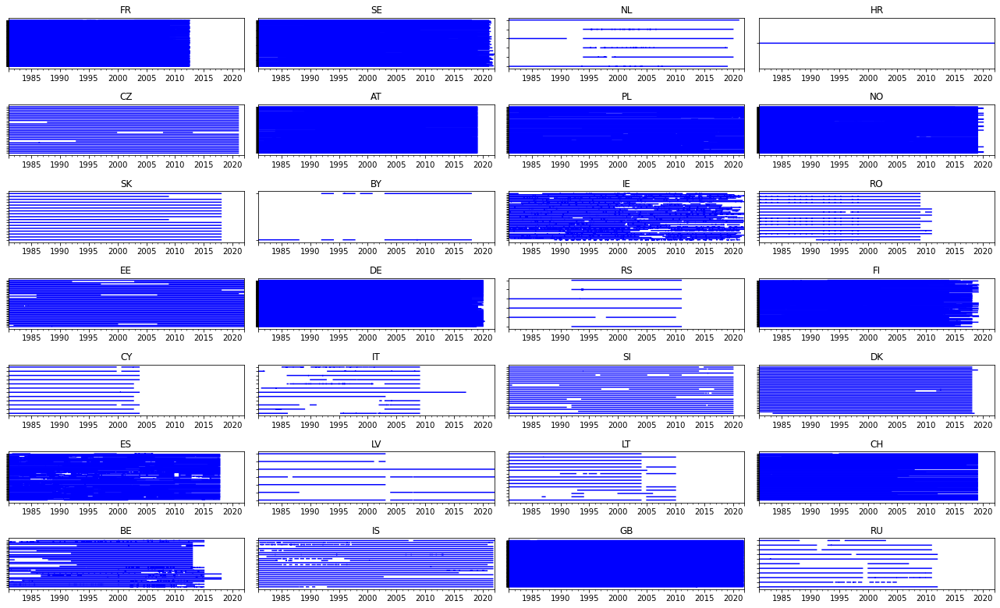

In [18]:
figplot, axesplot = geospatialfunctions.plotganntplots(numr = 7, numc = 4, timeseriesfinal_used = timeseriesfinal_used, 
               summarygapsstations = summarygapsstations,
               setylim = False,  ymin = 0, ymax = 100, figsize_chart = (18, 11), 
                color_chart = "blue", fontsize_chart = 10, facecolor_chart = "white", title_chart = "Title")

Here we start our exportation per country:

#### 1. Germany (DE):

In [52]:
# First we filter based on the country's code:
summarygapsstations_DE = summarygapsstations[summarygapsstations.Country == "DE"]
summarygapsstations_DE

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6321100,6.151000,51.684000,61.0,0.439513,DE,1203.0,12.02,6211,NIERS,GOCH,1950-01-01,2018-01-01
6321200,6.104184,51.097604,62.0,0.446718,DE,2105.0,32.45,6211,ROER,STAH,1960-01-01,2018-01-01
6334270,9.022802,54.699745,1413.0,10.180849,DE,352.0,1.70,6340,SOHOLMER AU,SOHOLM,1984-01-01,2019-01-01
6334280,8.976074,54.770658,6513.0,46.927012,DE,134.0,2.31,6340,LECKER AU,LECK-KARLSMARK,1984-01-01,2004-01-01
6334800,9.317255,54.514342,0.0,0.000000,DE,481.0,5.00,6340,TREENE,TREIA,1931-01-01,2019-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...
6357501,14.706722,51.969270,0.0,0.000000,DE,4080.0,37.48,6571,LUSATIAN NEISSE RIVER,GUBEN 2,1959-01-01,2019-01-01
6357502,14.993192,51.161160,0.0,0.000000,DE,1621.0,175.63,6571,LUSATIAN NEISSE RIVER,GOERLITZ,1912-01-01,2019-01-01
6357503,14.821047,50.872211,1156.0,8.329130,DE,376.0,233.14,6571,LUSATIAN NEISSE RIVER,HARTAU,1957-01-01,2016-01-01


In [53]:
idcondition = summarygapsstations_DE[summarygapsstations_DE.PercentageGaps < 50].index.tolist()
len(idcondition)

320

In [54]:
timeseries_DE = timeseriesfinal_used.loc["1950":, idcondition]
timeseries_DE

,6321100,6321200,6334270,6334280,6334800,6335020,6335030,6335031,6335032,6335035,...,6343570,6343900,6357010,6357020,6357500,6357501,6357502,6357503,6357510,6357520
1950-01-01,NaN,NaN,NaN,NaN,7.10,1380.0,NaN,NaN,NaN,NaN,...,24.2,399.0,460.0,NaN,220.0,NaN,9.62,NaN,NaN,NaN
1950-01-02,NaN,NaN,NaN,NaN,5.83,1330.0,NaN,NaN,NaN,NaN,...,23.2,373.0,452.0,NaN,216.0,NaN,9.86,NaN,NaN,NaN
1950-01-03,NaN,NaN,NaN,NaN,5.83,1300.0,NaN,NaN,NaN,NaN,...,25.7,380.0,452.0,NaN,233.0,NaN,10.10,NaN,NaN,NaN
1950-01-04,NaN,NaN,NaN,NaN,5.72,1310.0,NaN,NaN,NaN,NaN,...,24.7,418.0,452.0,NaN,239.0,NaN,10.40,NaN,NaN,NaN
1950-01-05,NaN,NaN,NaN,NaN,4.71,1310.0,NaN,NaN,NaN,NaN,...,23.2,422.0,465.0,NaN,248.0,NaN,10.90,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [55]:
network_DE = summarygapsstations_DE.loc[idcondition, :]
network_DE

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6321100,6.151000,51.684000,61.0,0.439513,DE,1203.0,12.02,6211,NIERS,GOCH,1950-01-01,2018-01-01
6321200,6.104184,51.097604,62.0,0.446718,DE,2105.0,32.45,6211,ROER,STAH,1960-01-01,2018-01-01
6334270,9.022802,54.699745,1413.0,10.180849,DE,352.0,1.70,6340,SOHOLMER AU,SOHOLM,1984-01-01,2019-01-01
6334280,8.976074,54.770658,6513.0,46.927012,DE,134.0,2.31,6340,LECKER AU,LECK-KARLSMARK,1984-01-01,2004-01-01
6334800,9.317255,54.514342,0.0,0.000000,DE,481.0,5.00,6340,TREENE,TREIA,1931-01-01,2019-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...
6357501,14.706722,51.969270,0.0,0.000000,DE,4080.0,37.48,6571,LUSATIAN NEISSE RIVER,GUBEN 2,1959-01-01,2019-01-01
6357502,14.993192,51.161160,0.0,0.000000,DE,1621.0,175.63,6571,LUSATIAN NEISSE RIVER,GOERLITZ,1912-01-01,2019-01-01
6357503,14.821047,50.872211,1156.0,8.329130,DE,376.0,233.14,6571,LUSATIAN NEISSE RIVER,HARTAU,1957-01-01,2016-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

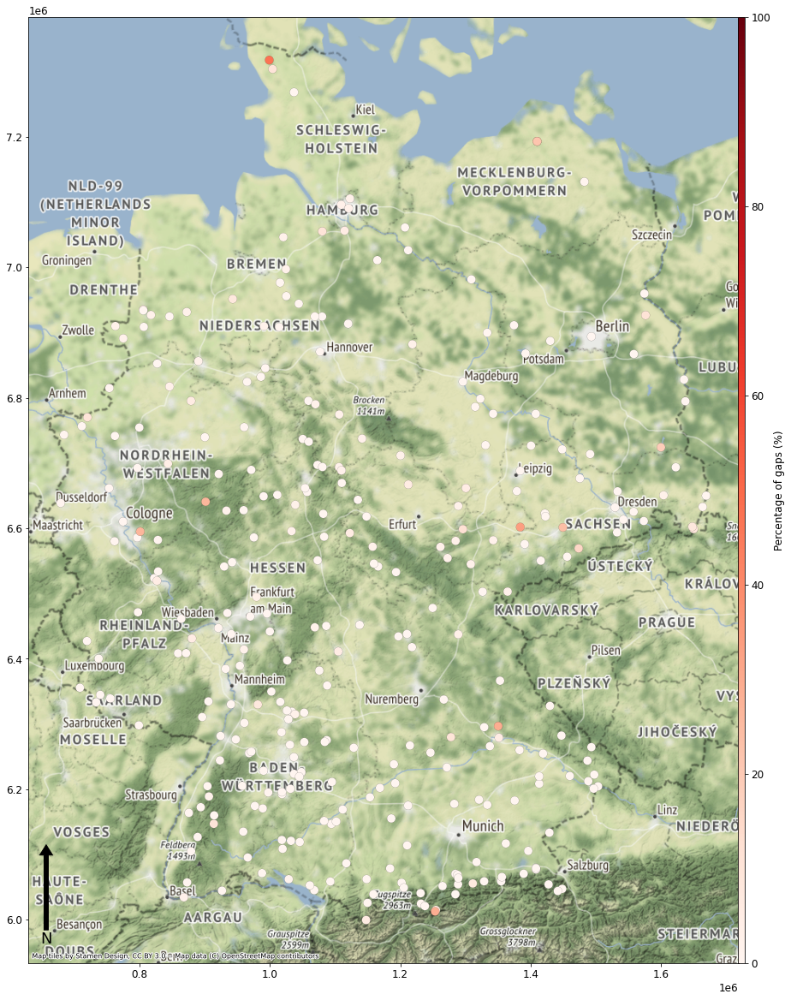

In [56]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_DE, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

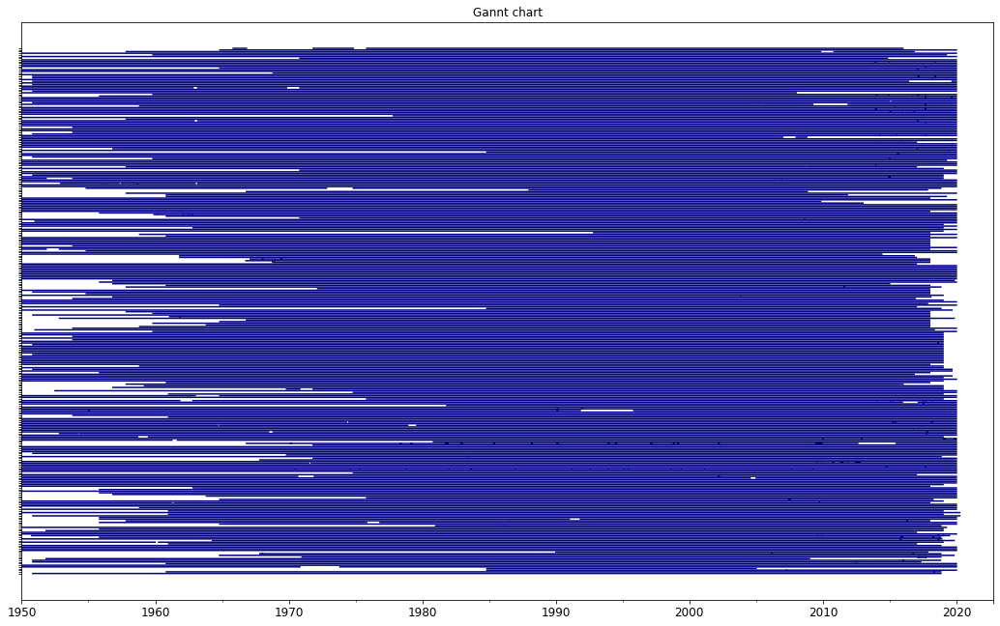

In [64]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_DE, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = False,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Germany")

In [57]:
# Here we can save our data time-series and network:
#timeseries_DE.to_excel(r'GRDC\timeseries\countries\timeseries_DE.xlsx') 
#network_DE.to_excel(r'GRDC\timeseries\countries\network_DE.xlsx') 


#### 2. Iceland (IS):

In [58]:
# First we filter based on the country's code:
summarygapsstations_IS = summarygapsstations[summarygapsstations.Country == "IS"]
summarygapsstations_IS

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6401070,-21.60337,64.71072,1359.0,9.791772,IS,507.0,18.0,6019,NORDHURA,STEKKUR,1971-01-01,2021-01-01
6401080,-21.41046,64.69229,0.0,0.000000,IS,1574.0,18.0,6019,HVITA,KLJAFOSS,1951-01-01,2021-01-01
6401090,-21.00666,63.93796,0.0,0.000000,IS,5662.0,12.0,6019,OLFUSA,SELFOSS,1950-01-01,2021-01-01
6401111,-20.55913,64.16010,0.0,0.000000,IS,640.0,57.0,6014,BRUARA,DYNJANDI,1948-01-01,2021-01-01
6401120,-20.63135,63.93362,0.0,0.000000,IS,7314.0,60.0,6019,THJORSA,KROKUR,1947-01-01,2021-01-01
6401130,-15.08830,64.98390,5966.0,42.985806,IS,558.0,50.0,6012,JOKULSA I FLJOTSDAL,HOLL,1962-01-01,2002-01-01
6401140,-20.11284,63.79723,0.0,0.000000,IS,419.0,59.0,6015,EYSTRI-RANGA,TUNGUFOSS,1962-01-01,2021-01-01
6401150,-20.34065,63.86324,1188.0,8.559695,IS,621.0,35.0,6015,YTRI-RANGA,ARBAEJARFOSS,1961-01-01,2015-01-01
6401160,-14.48605,64.75281,161.0,1.160026,IS,115.0,40.0,6019,FOSSA,EYJOLFSSTADIR,1968-01-01,2020-01-01


In [59]:
idcondition = summarygapsstations_IS[summarygapsstations_IS.PercentageGaps < 50].index.tolist()
len(idcondition)

24

In [60]:
timeseries_IS = timeseriesfinal_used.loc["1950":, idcondition]
timeseries_IS

,6401070,6401080,6401090,6401111,6401120,6401130,6401140,6401150,6401160,6401200,...,6401400,6401440,6401460,6401500,6401600,6401601,6401610,6401702,6401703,6401800
1950-01-01,NaN,NaN,NaN,78.9,506.42,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,NaN,47.0
1950-01-02,NaN,NaN,NaN,78.9,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,NaN,43.0
1950-01-03,NaN,NaN,NaN,78.9,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,NaN,39.0
1950-01-04,NaN,NaN,NaN,73.9,417.28,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,6.5,NaN,NaN,NaN,36.5
1950-01-05,NaN,NaN,NaN,73.9,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,6.5,NaN,NaN,NaN,34.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [61]:
network_IS = summarygapsstations_IS.loc[idcondition, :]
network_IS

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6401070,-21.60337,64.71072,1359.0,9.791772,IS,507.0,18.0,6019,NORDHURA,STEKKUR,1971-01-01,2021-01-01
6401080,-21.41046,64.69229,0.0,0.000000,IS,1574.0,18.0,6019,HVITA,KLJAFOSS,1951-01-01,2021-01-01
6401090,-21.00666,63.93796,0.0,0.000000,IS,5662.0,12.0,6019,OLFUSA,SELFOSS,1950-01-01,2021-01-01
6401111,-20.55913,64.16010,0.0,0.000000,IS,640.0,57.0,6014,BRUARA,DYNJANDI,1948-01-01,2021-01-01
6401120,-20.63135,63.93362,0.0,0.000000,IS,7314.0,60.0,6019,THJORSA,KROKUR,1947-01-01,2021-01-01
6401130,-15.08830,64.98390,5966.0,42.985806,IS,558.0,50.0,6012,JOKULSA I FLJOTSDAL,HOLL,1962-01-01,2002-01-01
6401140,-20.11284,63.79723,0.0,0.000000,IS,419.0,59.0,6015,EYSTRI-RANGA,TUNGUFOSS,1962-01-01,2021-01-01
6401150,-20.34065,63.86324,1188.0,8.559695,IS,621.0,35.0,6015,YTRI-RANGA,ARBAEJARFOSS,1961-01-01,2015-01-01
6401160,-14.48605,64.75281,161.0,1.160026,IS,115.0,40.0,6019,FOSSA,EYJOLFSSTADIR,1968-01-01,2020-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

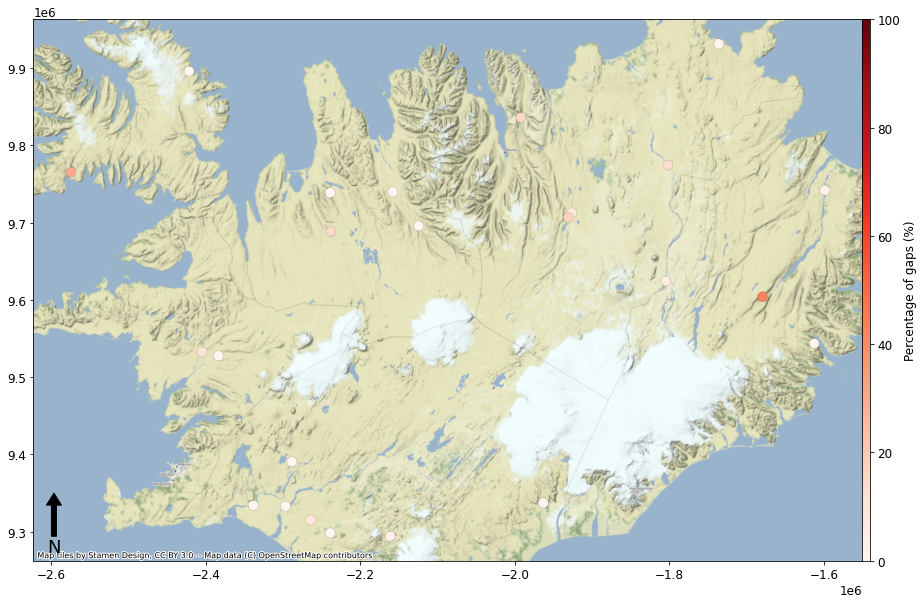

In [62]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_IS, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

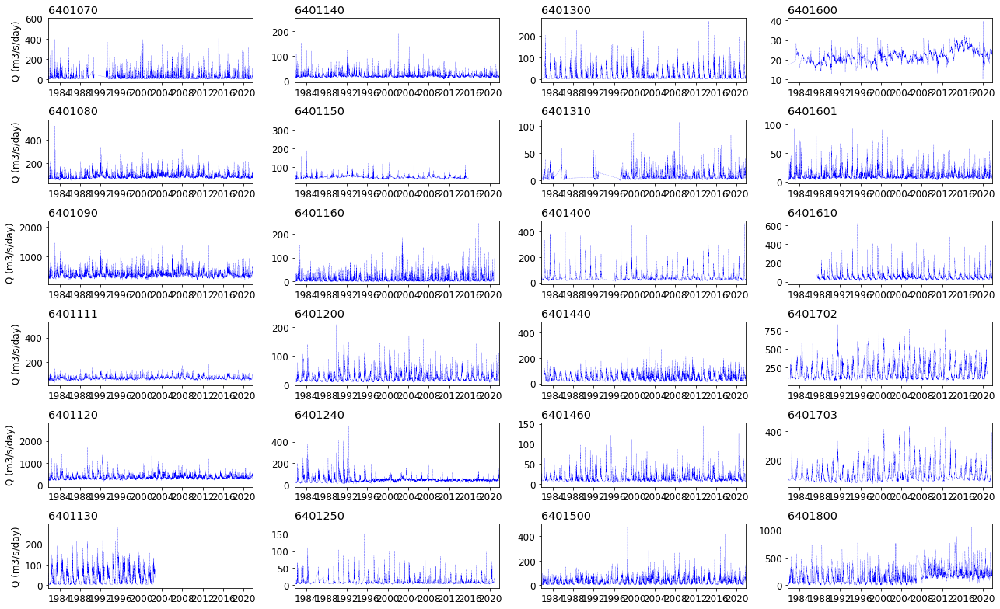

In [63]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 6, numc = 4, datatoplot = timeseries_IS, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

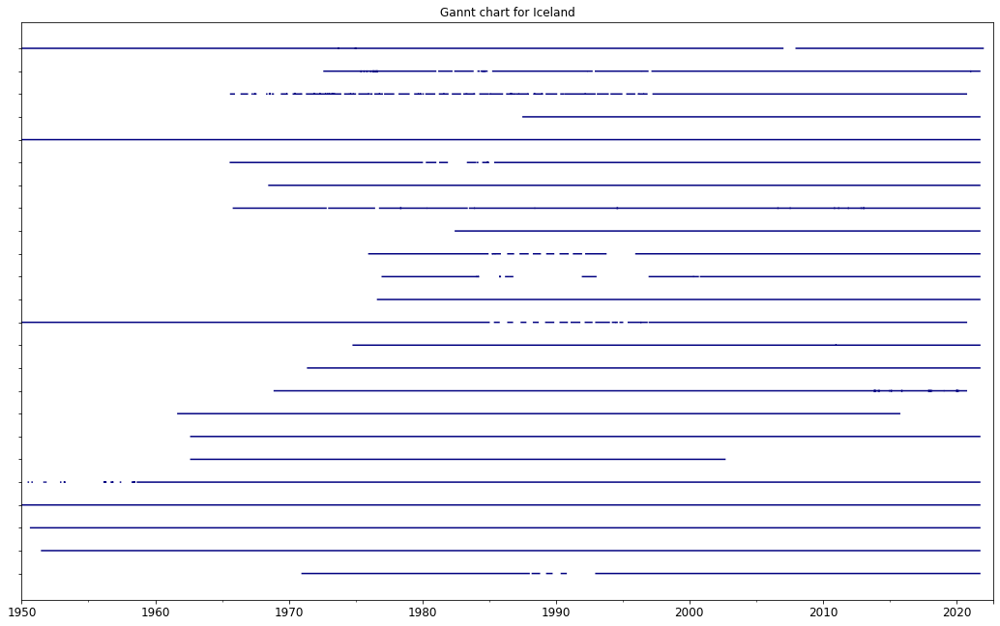

In [65]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_IS, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = False,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Iceland")

In [66]:
# Here we can save our data time-series and network:
timeseries_IS.to_excel(r'GRDC\timeseries\countries\timeseries_IS.xlsx') 
network_IS.to_excel(r'GRDC\timeseries\countries\network_IS.xlsx') 


#### 3. Poland (PL):

In [67]:
# First we filter based on the country's code:
summarygapsstations_PL = summarygapsstations[summarygapsstations.Country == "PL"]
summarygapsstations_PL

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6456105,15.613333,53.628889,0.0,0.0,PL,615.5,54.074,6560,REGA,LOBEZ,1955-01-01,2021-01-01
6456107,15.260833,54.063333,0.0,0.0,PL,2637.6,-0.169,6560,REGA,TRZEBIATOW,1949-01-01,2021-01-01
6456110,17.415556,54.419444,0.0,0.0,PL,437.0,66.990,6560,LUPAWA,LUPAWA,1960-01-01,2021-01-01
6456120,17.031389,54.470000,0.0,0.0,PL,1451.6,12.683,6560,SLUPIA,SLUPSK,1950-01-01,2021-01-01
6457010,14.317778,52.764167,0.0,0.0,PL,109810.7,2.980,6571,ODER RIVER,GOZDOWICE,1949-01-01,2021-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...
6458805,22.955000,52.948889,0.0,0.0,PL,3425.3,115.935,6581,NAREV,SURAZ,1950-01-01,2021-01-01
6458809,21.340833,53.386389,0.0,0.0,PL,232.4,119.420,6581,ROZOGA,MYSZYNIEC,1950-01-01,2021-01-01
6458863,21.792500,53.393056,0.0,0.0,PL,3575.7,104.765,6581,PISA,PTAKI,1950-01-01,2021-01-01


In [68]:
idcondition = summarygapsstations_PL[summarygapsstations_PL.PercentageGaps < 50].index.tolist()
len(idcondition)

82

In [69]:
timeseries_PL = timeseriesfinal_used.loc["1950":, idcondition]
timeseries_PL

,6456105,6456107,6456110,6456120,6457010,6457200,6457205,6457210,6457213,6457215,...,6458630,6458713,6458715,6458717,6458753,6458805,6458809,6458863,6458924,6458950
1950-01-01,NaN,27.2,NaN,NaN,481.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-02,NaN,26.4,NaN,NaN,479.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-03,NaN,25.2,NaN,NaN,476.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-04,NaN,23.2,NaN,NaN,474.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-05,NaN,22.0,NaN,NaN,486.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [77]:
network_PL = summarygapsstations_PL.loc[idcondition, :]
network_PL

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end,geometry
Code,,,,,,,,,,,,,
6456105,15.613333,53.628889,0.0,0.0,PL,615.5,54.074,6560,REGA,LOBEZ,1955-01-01,2021-01-01,POINT (15.61333 53.62889)
6456107,15.260833,54.063333,0.0,0.0,PL,2637.6,-0.169,6560,REGA,TRZEBIATOW,1949-01-01,2021-01-01,POINT (15.26083 54.06333)
6456110,17.415556,54.419444,0.0,0.0,PL,437.0,66.990,6560,LUPAWA,LUPAWA,1960-01-01,2021-01-01,POINT (17.41556 54.41944)
6456120,17.031389,54.470000,0.0,0.0,PL,1451.6,12.683,6560,SLUPIA,SLUPSK,1950-01-01,2021-01-01,POINT (17.03139 54.47000)
6457010,14.317778,52.764167,0.0,0.0,PL,109810.7,2.980,6571,ODER RIVER,GOZDOWICE,1949-01-01,2021-01-01,POINT (14.31778 52.76417)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6458805,22.955000,52.948889,0.0,0.0,PL,3425.3,115.935,6581,NAREV,SURAZ,1950-01-01,2021-01-01,POINT (22.95500 52.94889)
6458809,21.340833,53.386389,0.0,0.0,PL,232.4,119.420,6581,ROZOGA,MYSZYNIEC,1950-01-01,2021-01-01,POINT (21.34083 53.38639)
6458863,21.792500,53.393056,0.0,0.0,PL,3575.7,104.765,6581,PISA,PTAKI,1950-01-01,2021-01-01,POINT (21.79250 53.39306)


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

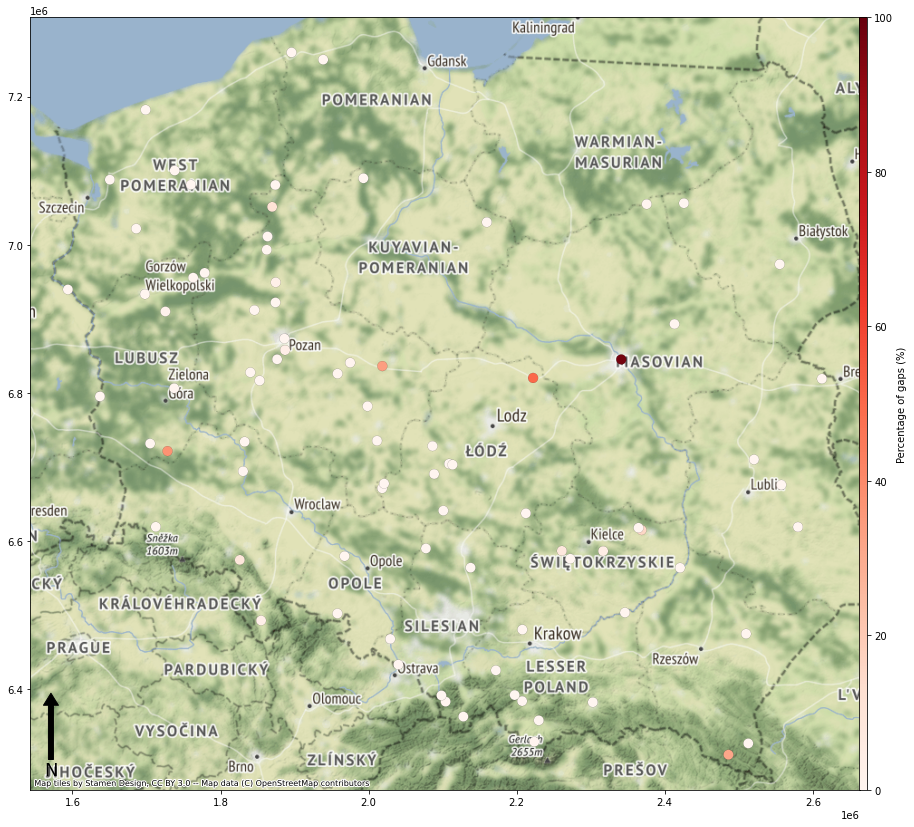

In [71]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_PL, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

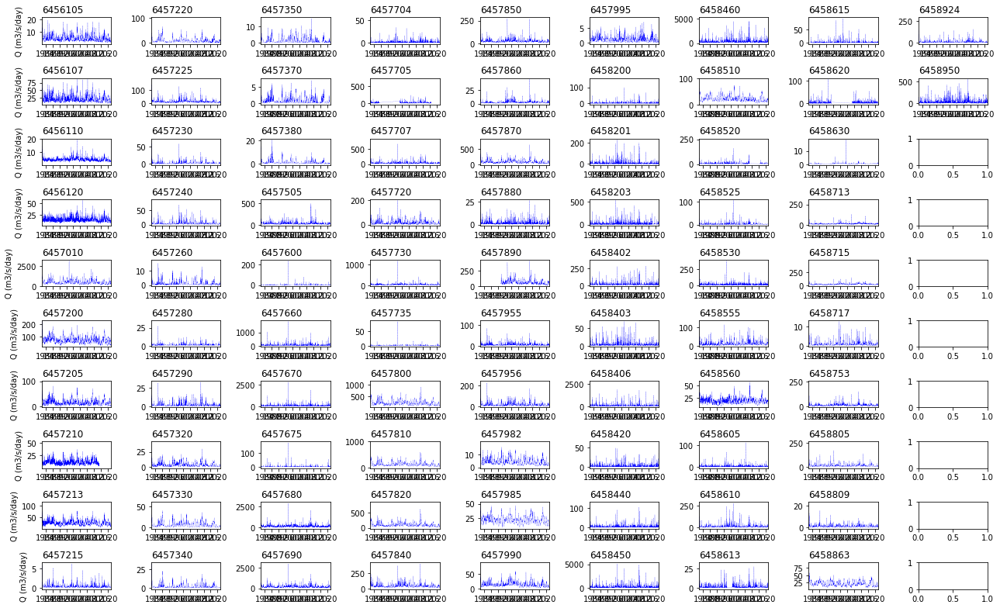

In [74]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 10, numc = 9, datatoplot = timeseries_PL, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

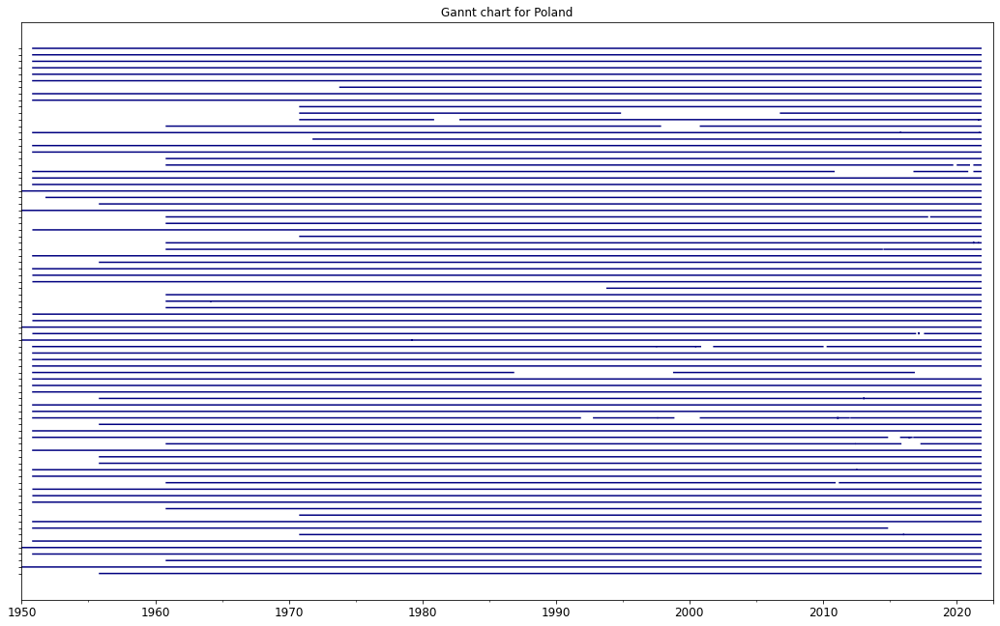

In [75]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_PL, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = False,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Poland")

In [78]:
# Here we can save our data time-series and network:
timeseries_PL.to_excel(r'GRDC\timeseries\countries\timeseries_PL.xlsx') 
network_PL.to_excel(r'GRDC\timeseries\countries\network_PL.xlsx') 


#### 4. Latvia (LV):

In [19]:
# This is a simple function to automatize the process of extracting the time-series for each country:
def extract_data_grdc(timeseries_GRDC, summarygapsstations, country_code = "LV", gaps_perc = 50.0):
    
    # First we filter based on the country's code:
    summarygapsstations_country = summarygapsstations[summarygapsstations.Country == country_code]
    
    # Here we apply another condition for the number of gaps:
    idcondition = summarygapsstations_country[summarygapsstations_country.PercentageGaps < gaps_perc].index.tolist()
    
    # Here we filter again but this time for our final time-series:
    timeseries_country = timeseriesfinal_used.loc["1950":, idcondition]
    
    # And here we filter our network of stations:
    network_country = summarygapsstations_country.loc[idcondition, :]
    
    # We can return the initial summarygapsstations_country, since it will provide information about the number of stations 
    # for the given country. The final time-series and the final network:
    return summarygapsstations_country, timeseries_country, network_country

In [100]:
summarygapsstations_LV, timeseries_LV, network_LV = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "LV", gaps_perc = 50.0)

(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

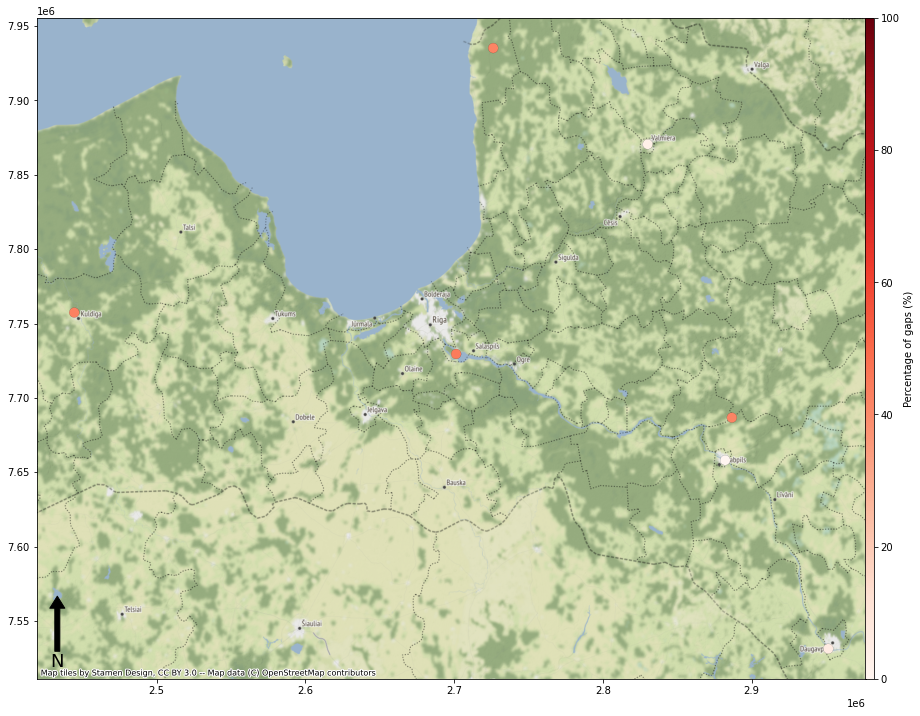

In [83]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_LV, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

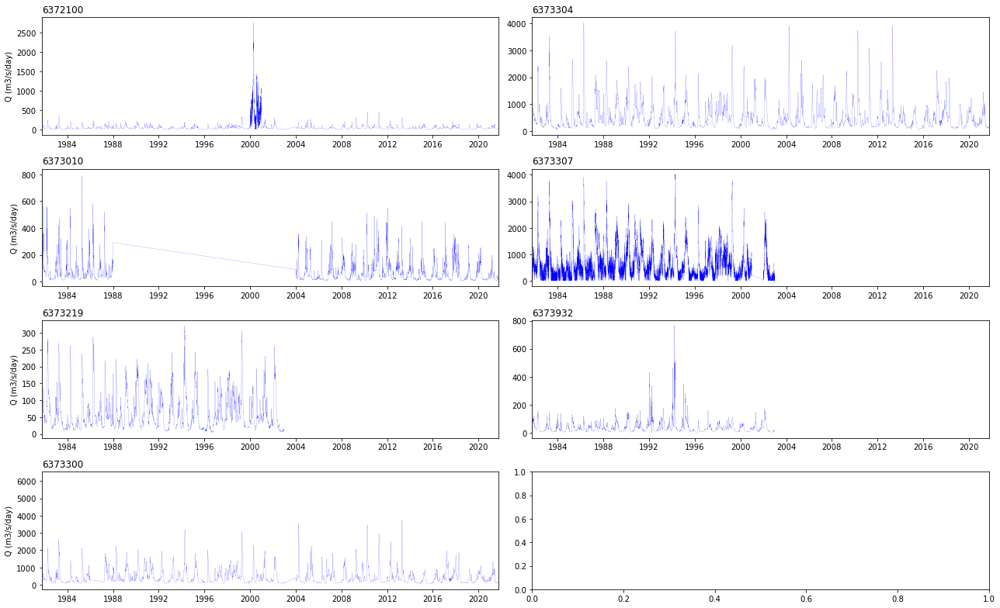

In [86]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 4, numc = 2, datatoplot = timeseries_LV, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

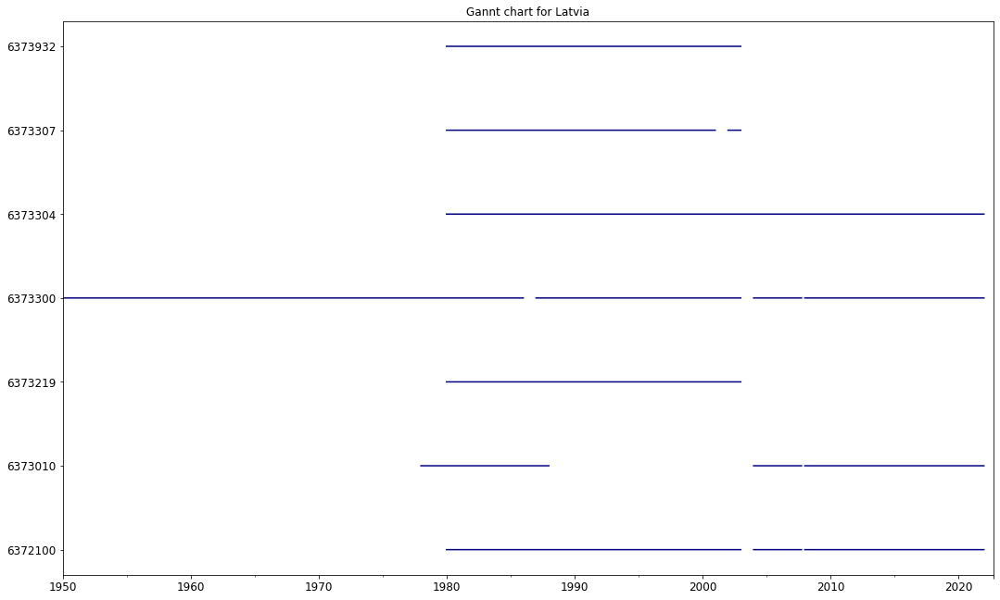

In [88]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_LV, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Latvia")

Visually, it seems that there is an error in this time-period for this station. Therefore we will fill it with NaNs to avoid any further problem in our analysis:

<AxesSubplot:>

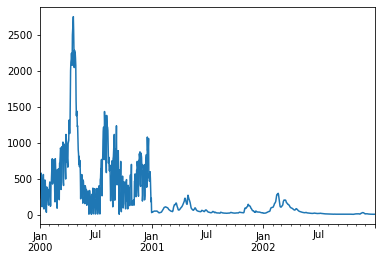

In [93]:
timeseries_LV.loc["2000":"2002", 6372100].plot()

In [94]:
timeseries_LV.loc["2000":"2000", 6372100] = np.nan

<AxesSubplot:>

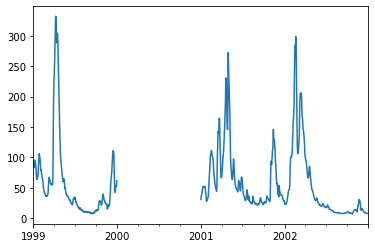

In [95]:
timeseries_LV.loc["1999":"2002", 6372100].plot()

In [96]:
# Here we can save our data time-series and network:
timeseries_LV.to_excel(r'GRDC\timeseries\countries\timeseries_LV.xlsx') 
network_LV.to_excel(r'GRDC\timeseries\countries\network_LV.xlsx') 

#### 5. Estonia (EE):

In [105]:
summarygapsstations_EE, timeseries_EE, network_EE = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "EE", gaps_perc = 50.0)

In [111]:
timeseries_EE.head()

,6172010,6172011,6172012,6172013,6172014,6172016,6172020,6172023,6172024,6172026,...,6172220,6172224,6172230,6172236,6172240,6172260,6172270,6172280,6172350,6172351
1950-01-01,0.64,NaN,NaN,8.71,NaN,6.81,NaN,26.3,NaN,3.21,...,6.55,0.052,NaN,11.9,6.59,NaN,NaN,NaN,NaN,214.0
1950-01-02,0.49,NaN,NaN,8.52,NaN,5.51,NaN,23.5,NaN,2.36,...,5.57,0.050,NaN,11.5,6.28,NaN,NaN,NaN,NaN,199.0
1950-01-03,0.42,NaN,NaN,8.16,NaN,5.69,NaN,22.0,NaN,2.10,...,4.83,0.047,NaN,11.2,5.98,NaN,NaN,NaN,NaN,182.0
1950-01-04,0.39,NaN,NaN,7.44,NaN,4.87,NaN,21.4,NaN,2.10,...,4.35,0.043,NaN,10.8,5.68,NaN,NaN,NaN,NaN,169.0
1950-01-05,0.35,NaN,NaN,6.36,NaN,4.59,NaN,20.9,NaN,2.10,...,3.88,0.041,NaN,10.4,5.37,NaN,NaN,NaN,NaN,132.0


In [110]:
network_EE.head()

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6172010,24.968889,59.380833,62.0,0.446718,EE,84.0,33.60,6720,LEIVAJOGI,PAJUPEA,1928-01-01,2021-01-01
6172011,25.340278,59.344167,365.0,2.629872,EE,903.0,40.12,6720,JAGALA,KEHRA,1982-01-01,2021-01-01
6172012,24.879167,59.466111,2557.0,18.423518,EE,794.0,5.98,6720,PIRITA JOGI,KLOOSTRIMETSA,1973-01-01,2021-01-01
6172013,24.434722,59.308611,0.0,0.000000,EE,635.0,23.77,6720,KEILA JOGI,KEILA,1923-01-01,2021-01-01
6172014,25.594444,59.508611,0.0,0.000000,EE,123.0,8.62,6720,PUDISOO JOGI,PUDISOO,1961-01-01,2021-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

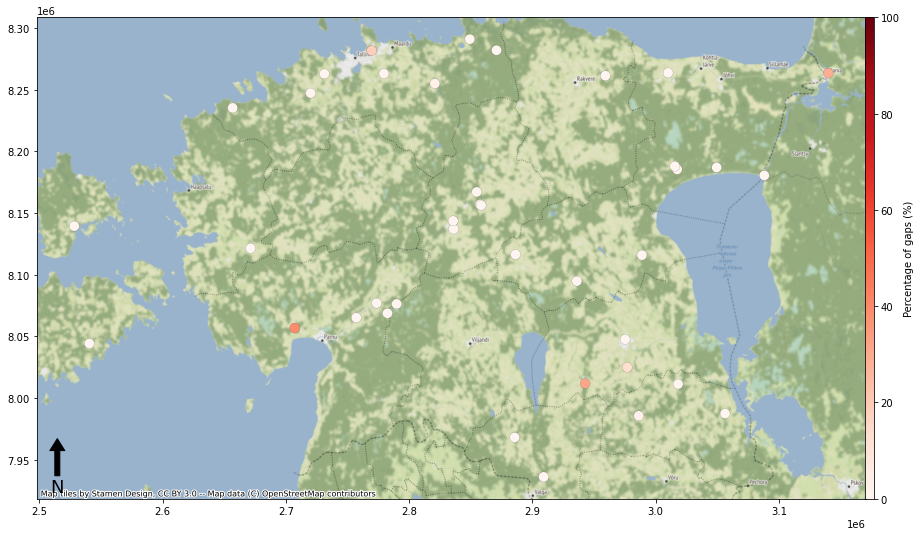

In [112]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_EE, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

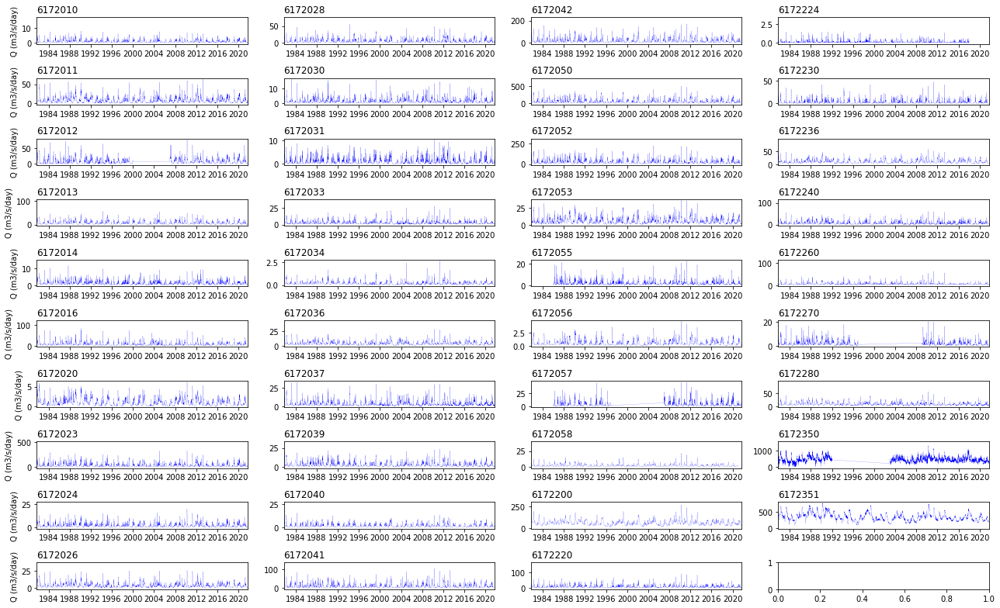

In [114]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 10, numc = 4, datatoplot = timeseries_EE, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

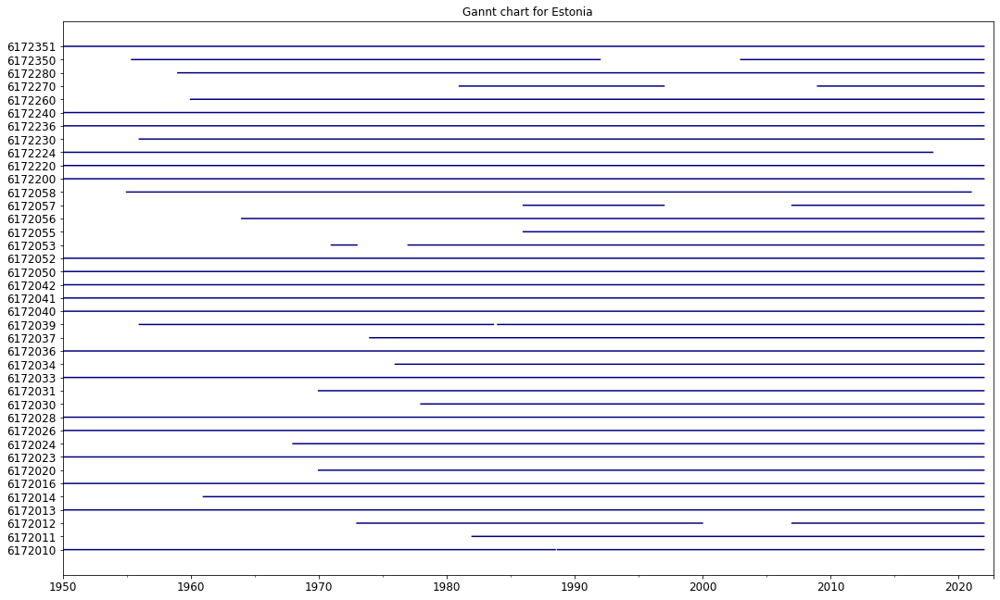

In [116]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_EE, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Estonia")

In [117]:
# Here we can save our data time-series and network:
timeseries_EE.to_excel(r'GRDC\timeseries\countries\timeseries_EE.xlsx') 
network_EE.to_excel(r'GRDC\timeseries\countries\network_EE.xlsx') 

#### 6. Lithuania (LT):


In [119]:
summarygapsstations_LT, timeseries_LT, network_LT = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "LT", gaps_perc = 50.0)

In [120]:
summarygapsstations_LT.head()

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6573100,21.483333,55.933333,3653.0,26.320340,LT,1220.0,18.01,6730,MINIJA,KARTENA,1933-01-01,2009-01-01
6573150,21.500000,56.266700,11141.0,80.272354,LT,617.0,11.03,6730,BARTA,SKUODAS,1986-01-01,2009-01-01
6573163,21.233333,55.883333,10956.0,78.939405,LT,297.0,5.15,6730,AKMENA,KRETINGA,1992-01-01,2005-01-01
6574011,25.292600,54.688000,8036.0,57.900425,LT,623.0,92.67,6741,VILNIA,VILNIUS,1993-01-01,2009-01-01
6574150,22.579700,55.075600,3653.0,26.320340,LT,81200.0,7.33,6741,NEMUNAS,SMALININKAI,1812-01-01,2009-01-01


In [122]:
timeseries_LT.head()

,6573100,6574150,6574152,6574154,6574156,6574300,6574350,6574351,6574352,6574360,6574721
1950-01-01,23.60,424.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-02,19.50,416.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-03,13.60,395.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-04,7.97,387.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-05,10.30,352.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [123]:
network_LT

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6573100,21.483333,55.933333,3653.0,26.320340,LT,1220.0,18.01,6730,MINIJA,KARTENA,1933-01-01,2009-01-01
6574150,22.579700,55.075600,3653.0,26.320340,LT,81200.0,7.33,6741,NEMUNAS,SMALININKAI,1812-01-01,2009-01-01
6574152,23.995600,54.026662,5479.0,39.476908,LT,37400.0,77.49,6741,NEMUNAS,DRUSKININKAI,1980-01-01,2003-01-01
6574154,24.066667,54.566667,5479.0,39.476908,LT,42900.0,50.68,6741,NEMUNAS,NEMAJUNAI,1980-01-01,2003-01-01
6574156,23.983333,54.883333,5479.0,39.476908,LT,45700.0,NaN,6741,NEMUNAS,KAUNO HPS,1980-01-01,2003-01-01
6574300,23.850000,55.166700,5113.0,36.839830,LT,5510.0,20.00,6741,NEVEZIS,DASIUNAI,1960-01-01,2004-01-01
6574350,24.283300,55.083300,3653.0,26.320340,LT,24500.0,34.12,6741,NERIS,JONAVA,1960-01-01,2009-01-01
6574351,25.288000,54.689000,5479.0,39.476908,LT,15200.0,84.04,6741,NERIS,VILNIUS,1980-01-01,2003-01-01
6574352,25.704000,54.862800,5479.0,39.476908,LT,11100.0,106.44,6741,NERIS,BUIVYDZIAI,1980-01-01,2003-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

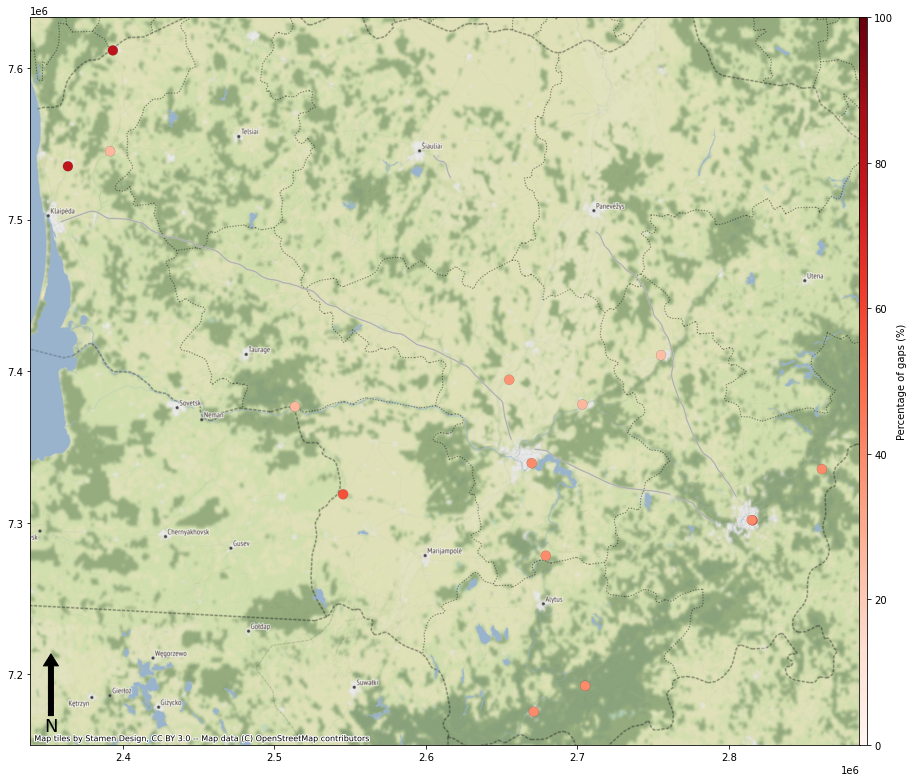

In [124]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_LT, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

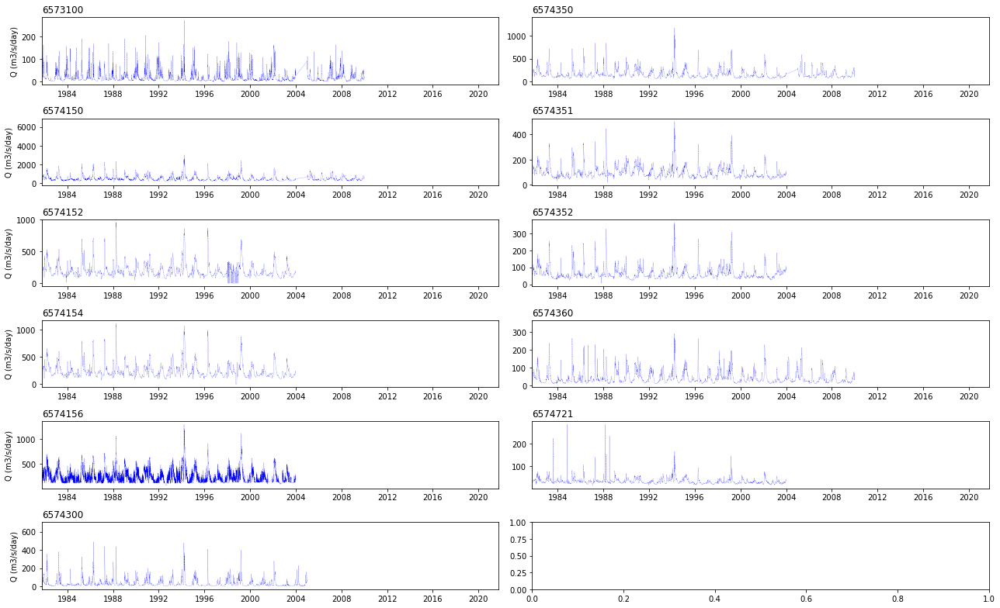

In [125]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 6, numc = 2, datatoplot = timeseries_LT, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

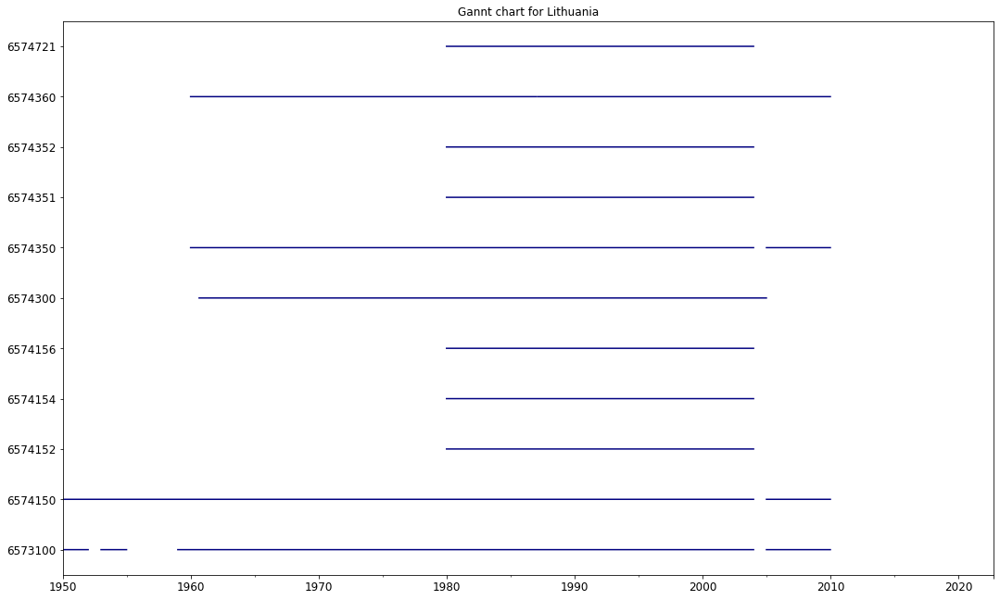

In [126]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_LT, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Lithuania")

<AxesSubplot:>

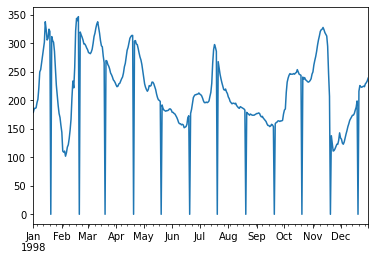

In [130]:
timeseries_LT.loc["1998":"1998", 6574152].plot()

In [131]:
timeseries_LT.loc["1998":"1998", 6574152] = np.nan

<AxesSubplot:>

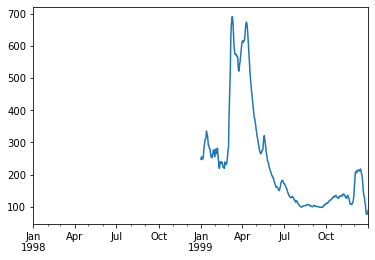

In [132]:
timeseries_LT.loc["1998":"1999", 6574152].plot()

In [133]:
# Here we can save our data time-series and network:
timeseries_LT.to_excel(r'GRDC\timeseries\countries\timeseries_LT.xlsx') 
network_LT.to_excel(r'GRDC\timeseries\countries\network_LT.xlsx') 

#### 7. Romania (RO): 

In [134]:
summarygapsstations_RO, timeseries_RO, network_RO = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "RO", gaps_perc = 50.0)

In [135]:
summarygapsstations_RO

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6742201,21.379444,44.814722,7310.0,52.669501,RO,570896.0,64.00,6421,DANUBE RIVER,BAZIAS,1991-01-01,2008-01-01
6742400,21.176944,45.645833,3652.0,26.313135,RO,4493.0,477.00,6421,TAMIS,SAG,1961-01-01,2008-01-01
6742451,24.299444,45.385000,2937.0,21.161467,RO,13733.0,312.23,6421,OLT,CORNET,1967-01-01,2010-01-01
6742500,25.354444,43.627222,2930.0,21.111031,RO,658400.0,16.00,6421,DANUBE RIVER,ZIMNICEA,1931-01-01,2010-01-01
6742552,23.789444,44.255555,3652.0,26.313135,RO,9334.0,446.00,6421,JIU,PODARI,1950-01-01,2008-01-01
6742600,26.812222,48.240833,3667.0,26.421212,RO,9074.0,101.87,6421,PRUT,RADAUTI,1960-01-01,2008-01-01
6742700,27.512222,45.555861,2937.0,21.161467,RO,36030.0,12.20,6421,SIRET,LUNGOCI,1953-01-01,2010-01-01
6742701,26.946111,46.725833,3667.0,26.421212,RO,11899.0,160.52,6421,SIRET,DRAGESTI,1962-01-01,2008-01-01
6742800,27.092010,44.683333,2922.0,21.053390,RO,709100.0,3.00,6421,DANUBE RIVER,HARSOVA,1931-01-01,2010-01-01


In [136]:
timeseries_RO

,6742400,6742451,6742500,6742552,6742600,6742700,6742701,6742800,6742900,6742912,6744100,6744200,6744201,6744500,6744600
1950-01-01,NaN,NaN,6050.0,44.2,NaN,NaN,NaN,6340.0,6370.0,11.9,NaN,NaN,NaN,57.0,11.0
1950-01-02,NaN,NaN,5760.0,48.0,NaN,NaN,NaN,6280.0,6300.0,10.6,NaN,NaN,NaN,49.0,9.0
1950-01-03,NaN,NaN,5520.0,46.6,NaN,NaN,NaN,6100.0,6180.0,10.2,NaN,NaN,NaN,50.0,7.4
1950-01-04,NaN,NaN,5270.0,39.4,NaN,NaN,NaN,5890.0,6000.0,14.7,NaN,NaN,NaN,36.5,6.6
1950-01-05,NaN,NaN,4990.0,38.2,NaN,NaN,NaN,5530.0,5840.0,16.2,NaN,NaN,NaN,25.2,7.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [137]:
network_RO

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6742400,21.176944,45.645833,3652.0,26.313135,RO,4493.0,477.00,6421,TAMIS,SAG,1961-01-01,2008-01-01
6742451,24.299444,45.385000,2937.0,21.161467,RO,13733.0,312.23,6421,OLT,CORNET,1967-01-01,2010-01-01
6742500,25.354444,43.627222,2930.0,21.111031,RO,658400.0,16.00,6421,DANUBE RIVER,ZIMNICEA,1931-01-01,2010-01-01
6742552,23.789444,44.255555,3652.0,26.313135,RO,9334.0,446.00,6421,JIU,PODARI,1950-01-01,2008-01-01
6742600,26.812222,48.240833,3667.0,26.421212,RO,9074.0,101.87,6421,PRUT,RADAUTI,1960-01-01,2008-01-01
6742700,27.512222,45.555861,2937.0,21.161467,RO,36030.0,12.20,6421,SIRET,LUNGOCI,1953-01-01,2010-01-01
6742701,26.946111,46.725833,3667.0,26.421212,RO,11899.0,160.52,6421,SIRET,DRAGESTI,1962-01-01,2008-01-01
6742800,27.092010,44.683333,2922.0,21.053390,RO,709100.0,3.00,6421,DANUBE RIVER,HARSOVA,1931-01-01,2010-01-01
6742900,28.716657,45.216667,3659.0,26.363571,RO,807000.0,0.60,6421,DANUBE RIVER,CEATAL IZMAIL,1931-01-01,2010-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

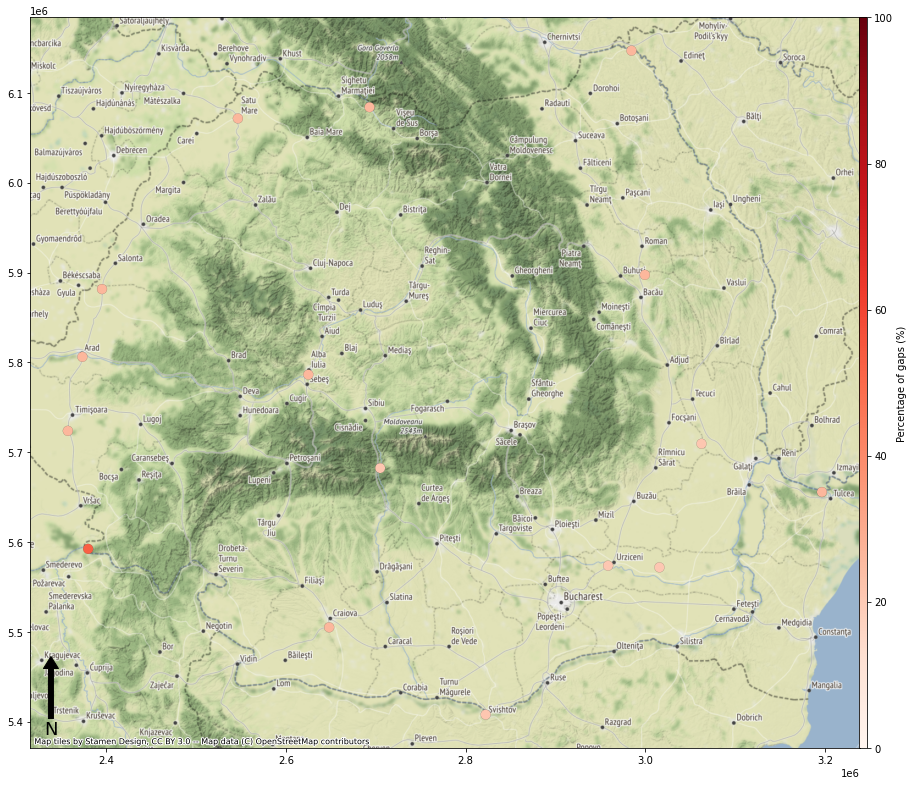

In [138]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_RO, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

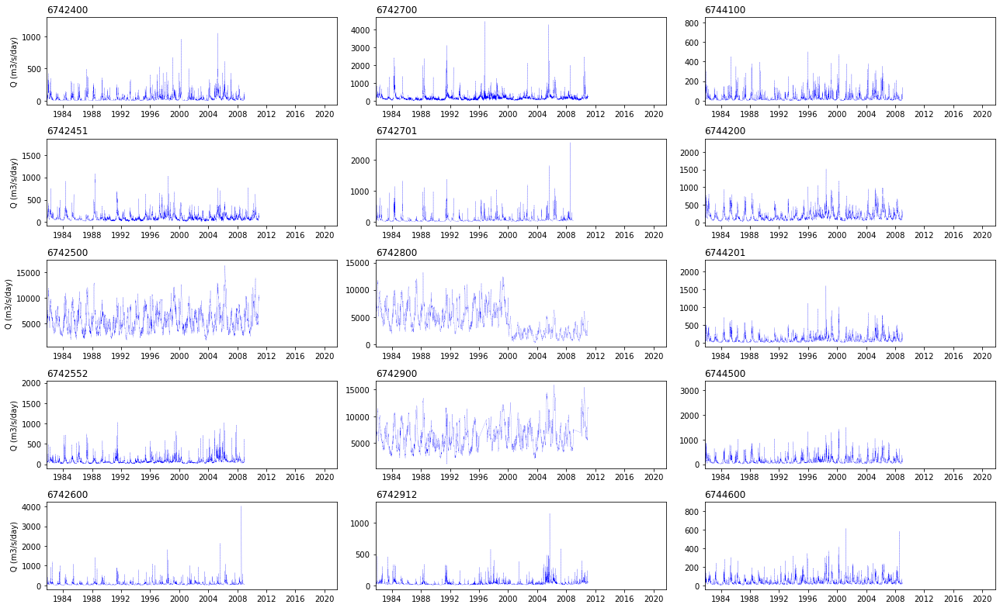

In [140]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 5, numc = 3, datatoplot = timeseries_RO, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

In [ ]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_LT, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Lithuania")

(<Figure size 1080x2160 with 1 Axes>, <AxesSubplot:>)

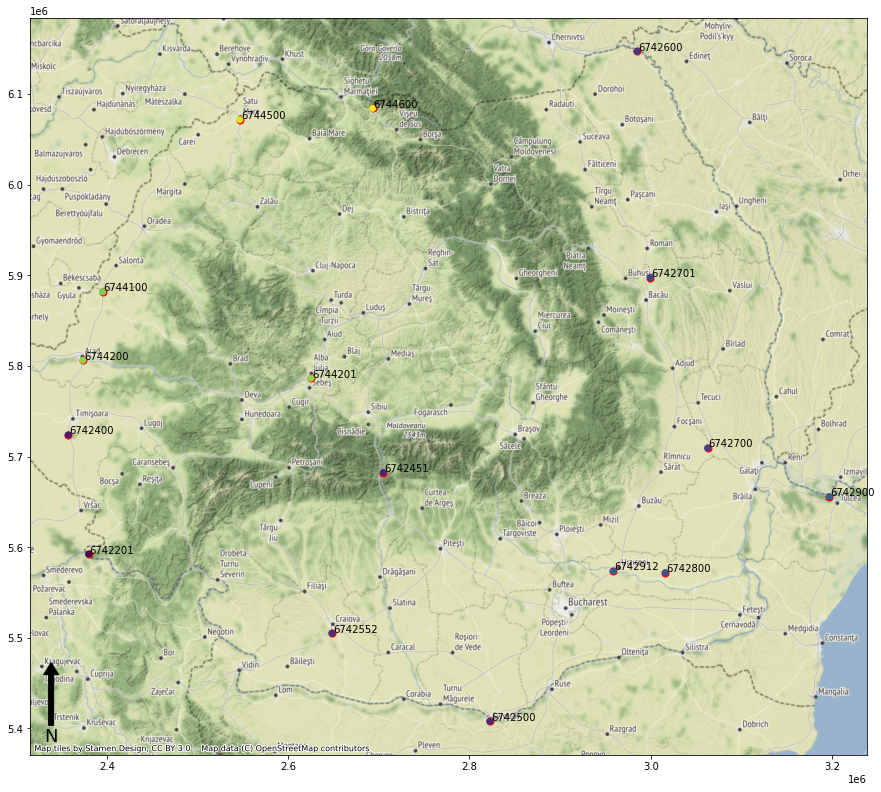

In [142]:
geospatialfunctions.plotpointsmap(summarygapsstations_RO, markersize_map = 50, colorpoints = 'red', showcodes= True)

As we can see in the plot, station 6742800 seems to present a problem. We will therefore delete it from our database:

In [144]:
network_RO.drop(6742800, inplace = True)

In [145]:
network_RO

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6742400,21.176944,45.645833,3652.0,26.313135,RO,4493.0,477.00,6421,TAMIS,SAG,1961-01-01,2008-01-01
6742451,24.299444,45.385000,2937.0,21.161467,RO,13733.0,312.23,6421,OLT,CORNET,1967-01-01,2010-01-01
6742500,25.354444,43.627222,2930.0,21.111031,RO,658400.0,16.00,6421,DANUBE RIVER,ZIMNICEA,1931-01-01,2010-01-01
6742552,23.789444,44.255555,3652.0,26.313135,RO,9334.0,446.00,6421,JIU,PODARI,1950-01-01,2008-01-01
6742600,26.812222,48.240833,3667.0,26.421212,RO,9074.0,101.87,6421,PRUT,RADAUTI,1960-01-01,2008-01-01
6742700,27.512222,45.555861,2937.0,21.161467,RO,36030.0,12.20,6421,SIRET,LUNGOCI,1953-01-01,2010-01-01
6742701,26.946111,46.725833,3667.0,26.421212,RO,11899.0,160.52,6421,SIRET,DRAGESTI,1962-01-01,2008-01-01
6742900,28.716657,45.216667,3659.0,26.363571,RO,807000.0,0.60,6421,DANUBE RIVER,CEATAL IZMAIL,1931-01-01,2010-01-01
6742912,26.578333,44.695555,2922.0,21.053390,RO,6265.0,490.00,6421,IALOMITA,COSERENI,1950-01-01,2010-01-01


In [146]:
timeseries_RO.drop(6742800, inplace = True, axis = 1)

In [147]:
timeseries_RO

,6742400,6742451,6742500,6742552,6742600,6742700,6742701,6742900,6742912,6744100,6744200,6744201,6744500,6744600
1950-01-01,NaN,NaN,6050.0,44.2,NaN,NaN,NaN,6370.0,11.9,NaN,NaN,NaN,57.0,11.0
1950-01-02,NaN,NaN,5760.0,48.0,NaN,NaN,NaN,6300.0,10.6,NaN,NaN,NaN,49.0,9.0
1950-01-03,NaN,NaN,5520.0,46.6,NaN,NaN,NaN,6180.0,10.2,NaN,NaN,NaN,50.0,7.4
1950-01-04,NaN,NaN,5270.0,39.4,NaN,NaN,NaN,6000.0,14.7,NaN,NaN,NaN,36.5,6.6
1950-01-05,NaN,NaN,4990.0,38.2,NaN,NaN,NaN,5840.0,16.2,NaN,NaN,NaN,25.2,7.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [148]:
# Here we can save our data time-series and network:
timeseries_RO.to_excel(r'GRDC\timeseries\countries\timeseries_RO.xlsx') 
network_RO.to_excel(r'GRDC\timeseries\countries\network_RO.xlsx') 

#### 8. Slovakia (SK):

In [149]:
summarygapsstations_SK, timeseries_SK, network_SK = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "SK", gaps_perc = 50.0)

In [150]:
summarygapsstations_SK

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6142150,16.93585,48.602130,365.0,2.629872,SK,24129.0,146.0,6421,MORAVA,MORAVSKY JAN,1921-01-01,2017-01-01
6142200,17.10924,48.139570,365.0,2.629872,SK,131331.0,128.0,6421,DANUBE RIVER,BRATISLAVA,1900-01-01,2017-01-01
6142520,18.17260,48.524290,365.0,2.629872,SK,2094.0,158.0,6421,NITRA,NITRIANSKA STREDA,1930-01-01,2017-01-01
6142551,18.78592,49.297250,365.0,2.629872,SK,955.0,346.0,6421,KYSUCA,KYSUCKE NOVE MESTO,1931-01-01,2017-01-01
6142601,19.74160,48.297660,365.0,2.629872,SK,686.0,172.0,6421,IPEL',HOLISA,1931-01-01,2017-01-01
6142620,17.88251,48.160500,365.0,2.629872,SK,11218.0,109.0,6421,VAH,SALA,1920-01-01,2017-01-01
6142640,18.91268,49.070400,365.0,2.629872,SK,827.0,390.0,6421,TURIEC,MARTIN,1931-01-01,2017-01-01
6142650,19.13000,48.730000,3713.0,26.752648,SK,1766.0,334.0,6421,HRON,BANSKA BYSTRICA,1930-01-01,2008-01-01
6142660,18.64649,48.407030,365.0,2.629872,SK,3821.0,195.0,6421,HRON,BREHY,1930-01-01,2017-01-01


In [151]:
timeseries_SK

,6142150,6142200,6142520,6142551,6142601,6142620,6142640,6142650,6142660,6142680,6144100,6144150,6144200,6144300,6144350,6144400,6158100
1950-01-01,98.0,1471.0,19.0,15.1,2.80,202.0,9.1,20.6,44.0,12.7,11.0,4.6,NaN,NaN,6.0,9.5,9.6
1950-01-02,85.0,1384.0,15.0,12.8,2.30,150.0,9.2,20.8,32.5,14.0,9.9,4.4,NaN,NaN,5.2,9.3,9.9
1950-01-03,75.0,1300.0,15.0,17.0,2.00,125.0,9.2,22.6,39.0,17.5,8.2,4.3,NaN,NaN,5.8,9.1,10.5
1950-01-04,80.0,1258.0,16.1,14.9,2.00,109.0,11.2,25.7,43.0,16.1,7.9,4.3,NaN,NaN,7.6,8.8,9.2
1950-01-05,76.0,1278.0,14.5,13.1,1.78,122.0,11.3,23.4,39.0,13.3,7.6,4.3,NaN,NaN,8.4,8.6,8.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [152]:
network_SK

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6142150,16.93585,48.602130,365.0,2.629872,SK,24129.0,146.0,6421,MORAVA,MORAVSKY JAN,1921-01-01,2017-01-01
6142200,17.10924,48.139570,365.0,2.629872,SK,131331.0,128.0,6421,DANUBE RIVER,BRATISLAVA,1900-01-01,2017-01-01
6142520,18.17260,48.524290,365.0,2.629872,SK,2094.0,158.0,6421,NITRA,NITRIANSKA STREDA,1930-01-01,2017-01-01
6142551,18.78592,49.297250,365.0,2.629872,SK,955.0,346.0,6421,KYSUCA,KYSUCKE NOVE MESTO,1931-01-01,2017-01-01
6142601,19.74160,48.297660,365.0,2.629872,SK,686.0,172.0,6421,IPEL',HOLISA,1931-01-01,2017-01-01
6142620,17.88251,48.160500,365.0,2.629872,SK,11218.0,109.0,6421,VAH,SALA,1920-01-01,2017-01-01
6142640,18.91268,49.070400,365.0,2.629872,SK,827.0,390.0,6421,TURIEC,MARTIN,1931-01-01,2017-01-01
6142650,19.13000,48.730000,3713.0,26.752648,SK,1766.0,334.0,6421,HRON,BANSKA BYSTRICA,1930-01-01,2008-01-01
6142660,18.64649,48.407030,365.0,2.629872,SK,3821.0,195.0,6421,HRON,BREHY,1930-01-01,2017-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

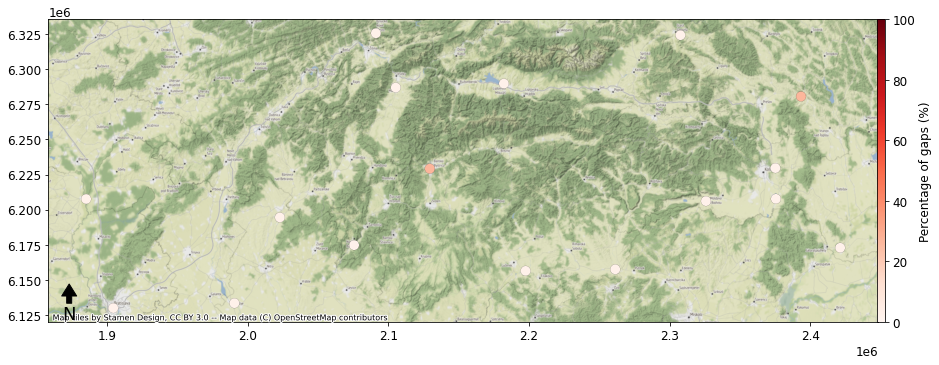

In [153]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_SK, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

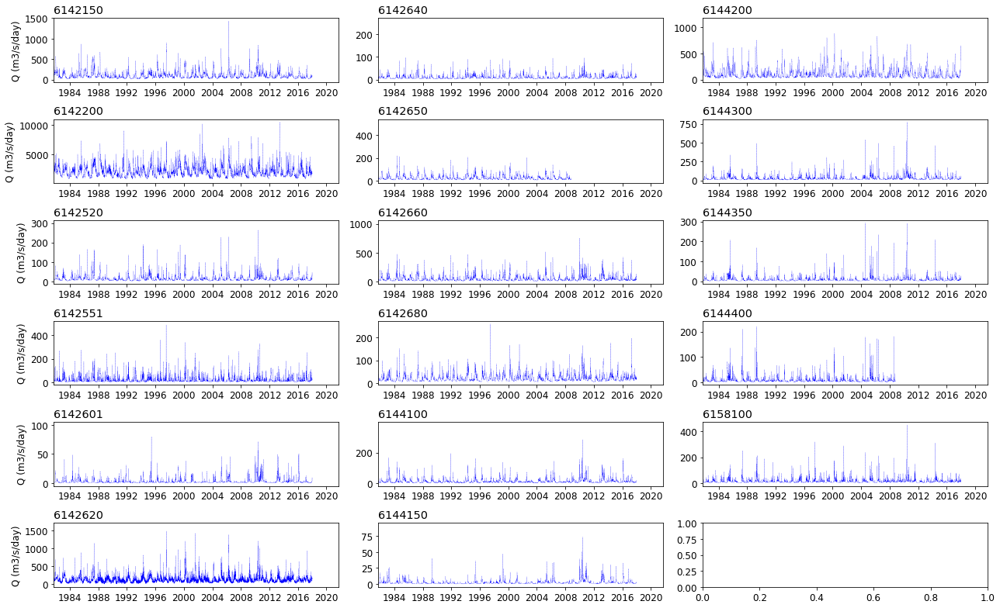

In [154]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 6, numc = 3, datatoplot = timeseries_SK, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

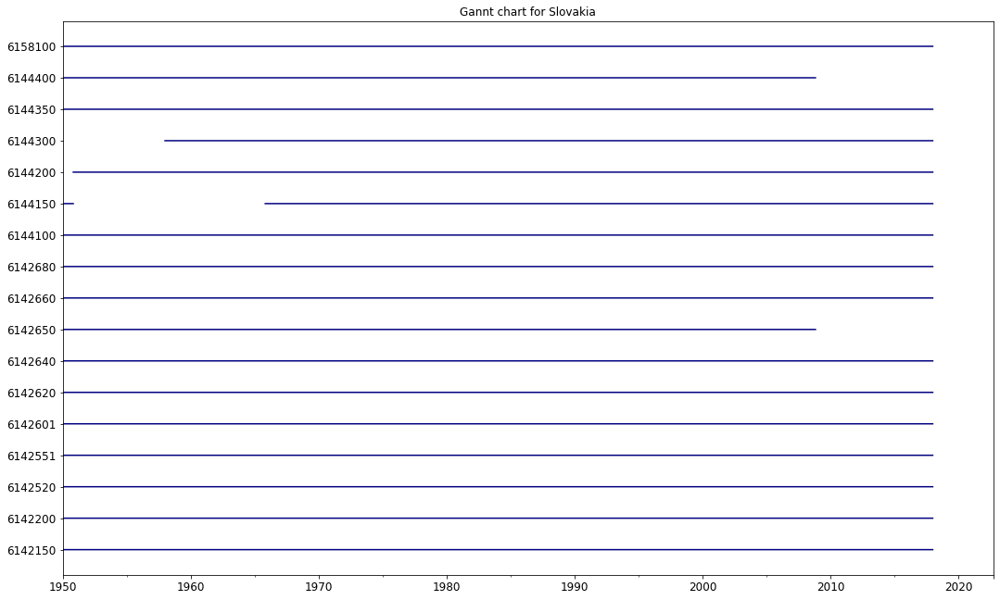

In [159]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_SK, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Slovakia")

In [160]:
# Here we can save our data time-series and network:
timeseries_SK.to_excel(r'GRDC\timeseries\countries\timeseries_SK.xlsx') 
network_SK.to_excel(r'GRDC\timeseries\countries\network_SK.xlsx') 

#### 9. Belarus (BY):


In [161]:
summarygapsstations_BY, timeseries_BY, network_BY = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "BY", gaps_perc = 50.0)

In [162]:
summarygapsstations_BY

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6273500,28.853796,55.544941,4382.0,31.572880,BY,618.0,NaN,6731,POLOTA,YANKOVO,1978-01-01,2017-01-01
6274600,26.728616,53.469681,6210.0,44.743858,BY,3070.0,145.0,6741,NEMUNAS,STOWBTSY,1978-01-01,2017-01-01


In [163]:
timeseries_BY

,6273500,6274600
1950-01-01,NaN,NaN
1950-01-02,NaN,NaN
1950-01-03,NaN,NaN
1950-01-04,NaN,NaN
1950-01-05,NaN,NaN
...,...,...
2022-09-26,NaN,NaN
2022-09-27,NaN,NaN
2022-09-28,NaN,NaN
2022-09-29,NaN,NaN


In [164]:
network_BY

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6273500,28.853796,55.544941,4382.0,31.572880,BY,618.0,NaN,6731,POLOTA,YANKOVO,1978-01-01,2017-01-01
6274600,26.728616,53.469681,6210.0,44.743858,BY,3070.0,145.0,6741,NEMUNAS,STOWBTSY,1978-01-01,2017-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

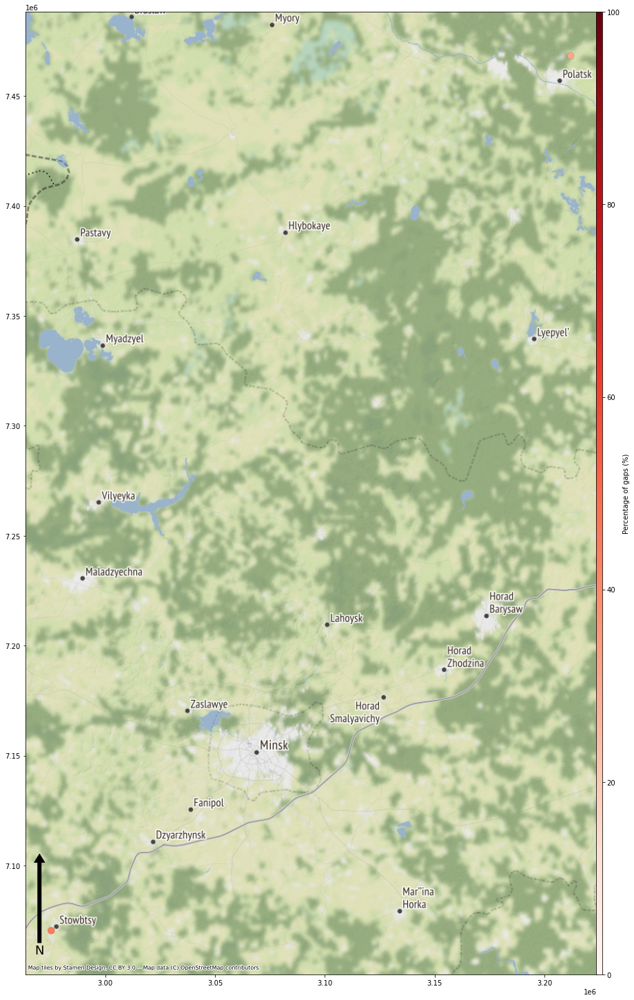

In [165]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_BY, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

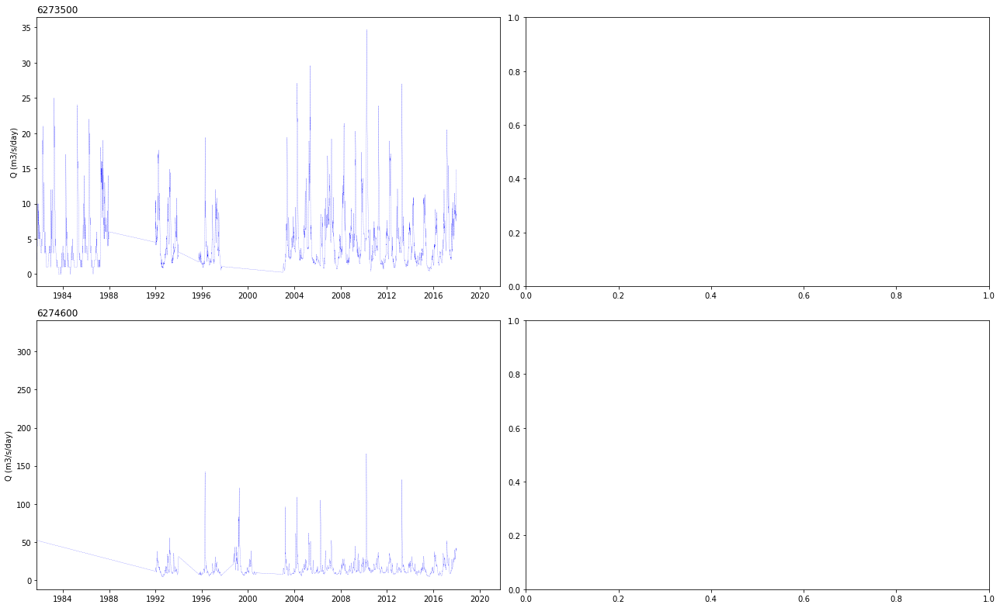

In [168]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 2, numc = 2, datatoplot = timeseries_BY, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

In [169]:
# Here we can save our data time-series and network:
timeseries_BY.to_excel(r'GRDC\timeseries\countries\timeseries_BY.xlsx') 
network_BY.to_excel(r'GRDC\timeseries\countries\network_BY.xlsx') 

#### 10. Russia (RU):


In [170]:
summarygapsstations_RU, timeseries_RU, network_RU = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "RU", gaps_perc = 50.0)

In [171]:
summarygapsstations_RU

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6955430,30.529444,59.837222,2557.0,18.423518,RU,281000.0,NaN,6551,NEVA,NOVOSARATOVKA,1945-01-01,2011-01-01
6970100,38.470000,63.820000,7126.0,51.343757,RU,55700.0,10.0,6706,ONEGA,POROG,1944-01-01,2004-01-01
6970250,41.920000,64.130000,3835.0,27.631674,RU,348000.0,2.0,6705,SEVERNAYA DVINA,UST'-PINEGA,1883-01-01,2010-01-01
6970500,45.620000,65.000000,3353.0,24.158801,RU,56400.0,18.0,6703,MEZEN',MALONISOGORSKAYA,1920-01-01,2010-01-01
6970700,52.170000,67.580000,3287.0,23.683262,RU,312000.0,NaN,6707,PECHORA,OKSINO,1980-01-01,2010-01-01
6970869,32.380000,66.870000,8766.0,63.160170,RU,25900.0,NaN,6702,KOVDA,KNYAZHEGUBSKOYE GES,1957-01-01,2006-01-01
6971130,31.750000,68.600000,2558.0,18.430723,RU,17500.0,NaN,6712,TULOMA,VERKHNE-TULOMSKIY GES,1935-01-01,2011-01-01
6971600,36.300000,66.400000,2922.0,21.053390,RU,7940.0,9.0,6713,VARZUGA,VARZUGA,1979-01-01,2011-01-01
6977100,44.585833,48.804722,3287.0,23.683262,RU,1360000.0,NaN,6771,VOLGA,VOLGOGRAD POWER PLANT,1962-01-01,2010-01-01


In [172]:
timeseries_RU

,6955430,6970250,6970500,6970700,6971130,6971600,6977100,6978250
1950-01-01,1970.0,NaN,250.0,NaN,97.8,NaN,NaN,NaN
1950-01-02,1960.0,NaN,242.0,NaN,97.1,NaN,NaN,NaN
1950-01-03,2030.0,NaN,230.0,NaN,96.4,NaN,NaN,NaN
1950-01-04,2000.0,NaN,224.0,NaN,95.7,NaN,NaN,NaN
1950-01-05,2010.0,NaN,219.0,NaN,95.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [173]:
network_RU

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6955430,30.529444,59.837222,2557.0,18.423518,RU,281000.0,NaN,6551,NEVA,NOVOSARATOVKA,1945-01-01,2011-01-01
6970250,41.920000,64.130000,3835.0,27.631674,RU,348000.0,2.0,6705,SEVERNAYA DVINA,UST'-PINEGA,1883-01-01,2010-01-01
6970500,45.620000,65.000000,3353.0,24.158801,RU,56400.0,18.0,6703,MEZEN',MALONISOGORSKAYA,1920-01-01,2010-01-01
6970700,52.170000,67.580000,3287.0,23.683262,RU,312000.0,NaN,6707,PECHORA,OKSINO,1980-01-01,2010-01-01
6971130,31.750000,68.600000,2558.0,18.430723,RU,17500.0,NaN,6712,TULOMA,VERKHNE-TULOMSKIY GES,1935-01-01,2011-01-01
6971600,36.300000,66.400000,2922.0,21.053390,RU,7940.0,9.0,6713,VARZUGA,VARZUGA,1979-01-01,2011-01-01
6977100,44.585833,48.804722,3287.0,23.683262,RU,1360000.0,NaN,6771,VOLGA,VOLGOGRAD POWER PLANT,1962-01-01,2010-01-01
6978250,40.647222,47.540833,3654.0,26.327545,RU,378000.0,58.0,6781,DON,RAZDORSKAYA,1952-01-01,2010-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

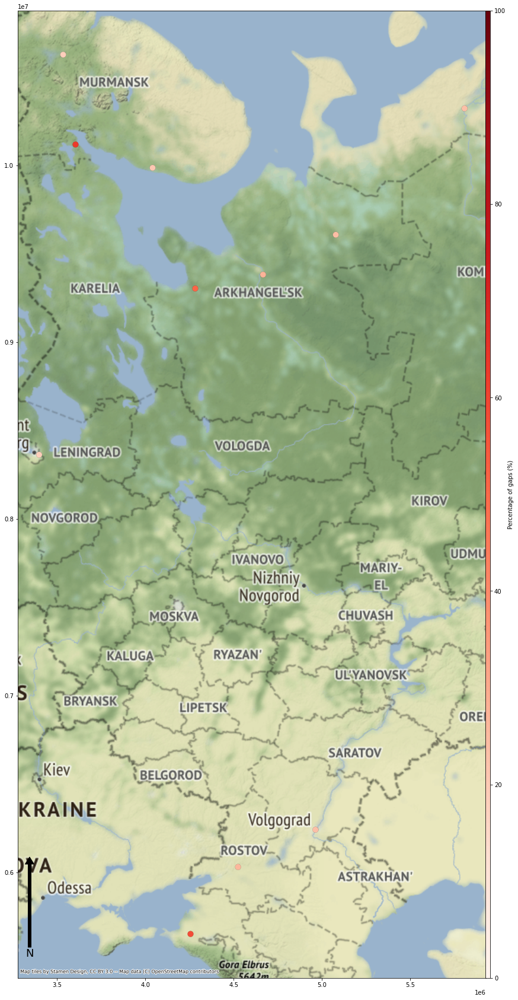

In [174]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_RU, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

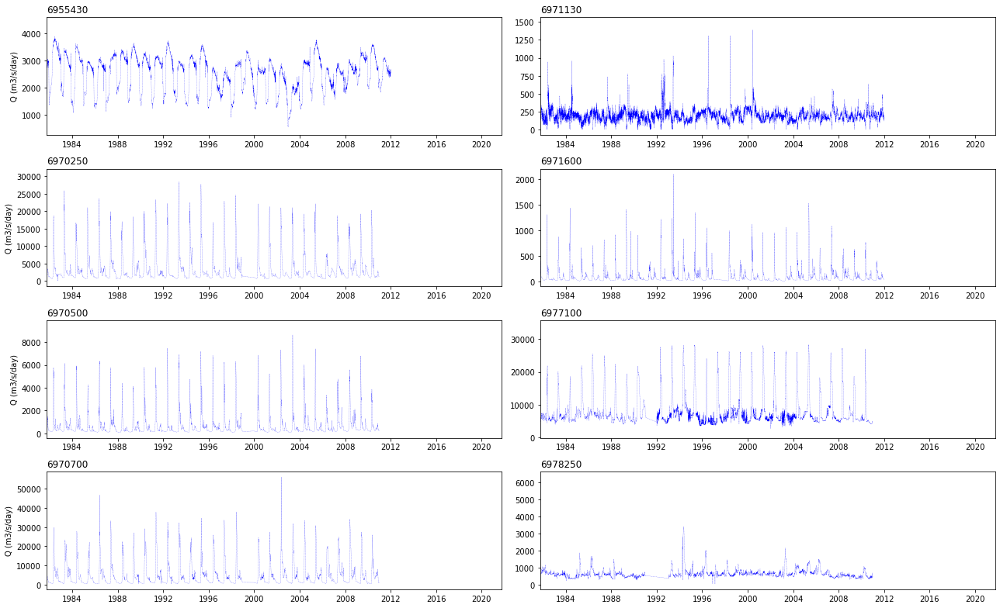

In [176]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 4, numc = 2, datatoplot = timeseries_RU, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

In [177]:
# Here we can save our data time-series and network:
timeseries_RU.to_excel(r'GRDC\timeseries\countries\timeseries_RU.xlsx') 
network_RU.to_excel(r'GRDC\timeseries\countries\network_RU.xlsx') 

#### 11. Cyprus (CY):


In [178]:
summarygapsstations_CY, timeseries_CY, network_CY = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "CY", gaps_perc = 50.0)

In [179]:
summarygapsstations_CY

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6196020,32.420556,35.042778,5571.0,40.139780,CY,195.0,5.0,6960,CHRYSOCHOU,COAST,1979-01-01,2003-01-01
6196040,32.487500,34.741667,5936.0,42.769652,CY,210.0,27.0,6960,POTAMOS TIS EZOUSAS,AKHELIA,1965-01-01,2002-01-01
6196060,32.575000,34.708333,5937.0,42.776857,CY,260.0,22.0,6960,DIARIZOS,KOUKLIA,1965-01-01,2003-01-01
6196100,32.720000,35.080000,5936.0,42.769652,CY,48.7,240.0,6960,LIMNITIS,LIMNITIS SAW MILL,1966-01-01,2002-01-01
6196200,32.901389,35.041389,5936.0,42.769652,CY,63.0,396.0,6960,KARGOTIS,EVRYKHOU,1965-01-01,2002-01-01
6196300,33.016667,35.079167,5579.0,40.197421,CY,81.0,290.0,6960,ELIA,VYZAKIA,1965-01-01,2003-01-01
6196350,33.100000,34.754167,5936.0,42.769652,CY,110.0,100.0,6960,GERMASOGEIA,PHINIKARIA,1968-01-01,2002-01-01
6196400,33.183333,35.037500,5936.0,42.769652,CY,90.0,350.0,6960,AKAKI,MALOUNDA,1965-01-01,2002-01-01
6196480,33.300000,34.766667,5571.0,40.139780,CY,130.0,43.0,6960,VASILIKOS,KALAVASOS,1965-01-01,2003-01-01


In [180]:
timeseries_CY

,6196020,6196040,6196060,6196100,6196200,6196300,6196350,6196400,6196480,6196600,6196650,6196700
1950-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [181]:
network_CY

,CoordX,CoordY,NumGaps,PercentageGaps,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,
6196020,32.420556,35.042778,5571.0,40.139780,CY,195.0,5.0,6960,CHRYSOCHOU,COAST,1979-01-01,2003-01-01
6196040,32.487500,34.741667,5936.0,42.769652,CY,210.0,27.0,6960,POTAMOS TIS EZOUSAS,AKHELIA,1965-01-01,2002-01-01
6196060,32.575000,34.708333,5937.0,42.776857,CY,260.0,22.0,6960,DIARIZOS,KOUKLIA,1965-01-01,2003-01-01
6196100,32.720000,35.080000,5936.0,42.769652,CY,48.7,240.0,6960,LIMNITIS,LIMNITIS SAW MILL,1966-01-01,2002-01-01
6196200,32.901389,35.041389,5936.0,42.769652,CY,63.0,396.0,6960,KARGOTIS,EVRYKHOU,1965-01-01,2002-01-01
6196300,33.016667,35.079167,5579.0,40.197421,CY,81.0,290.0,6960,ELIA,VYZAKIA,1965-01-01,2003-01-01
6196350,33.100000,34.754167,5936.0,42.769652,CY,110.0,100.0,6960,GERMASOGEIA,PHINIKARIA,1968-01-01,2002-01-01
6196400,33.183333,35.037500,5936.0,42.769652,CY,90.0,350.0,6960,AKAKI,MALOUNDA,1965-01-01,2002-01-01
6196480,33.300000,34.766667,5571.0,40.139780,CY,130.0,43.0,6960,VASILIKOS,KALAVASOS,1965-01-01,2003-01-01


(<Figure size 1080x2160 with 2 Axes>, <AxesSubplot:>)

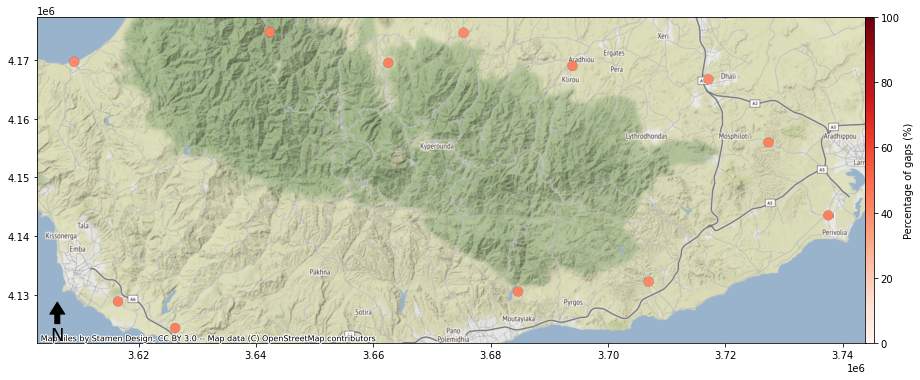

In [182]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_CY, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)

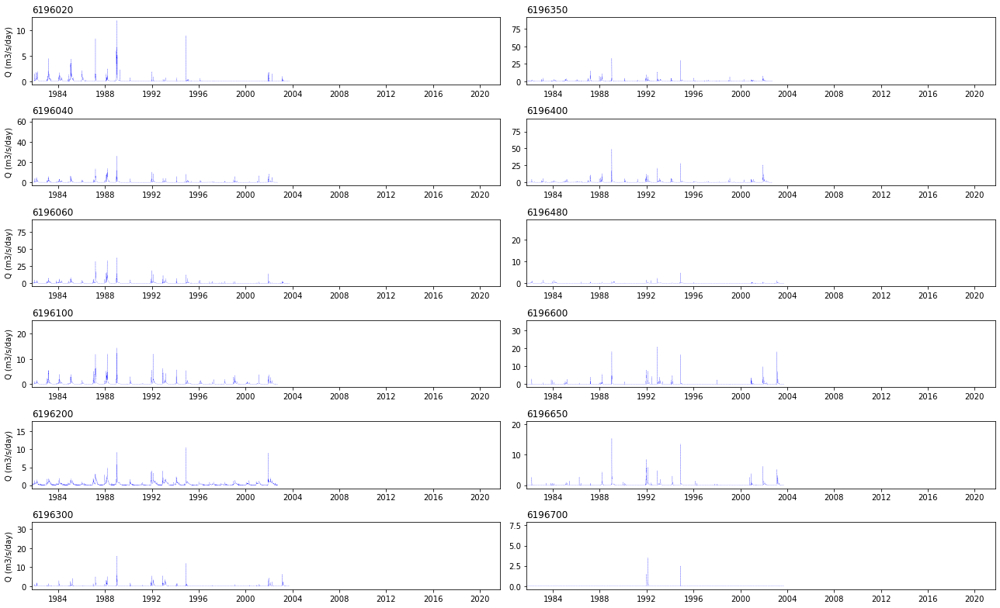

In [184]:
figplot, axesplot = geospatialfunctions.plottimeseries(numr = 6, numc = 2, datatoplot = timeseries_CY, 
                                   setylim = False, ymin = 0, ymax = 200, figsizeproj = (18, 11),
                                   colorgraph = "blue", linewidthproj = 0.2, linestyleproj = "-.",  
                                   ylabelplot = "Q (m3/s/day)", 
                                   datestart = datetime.date(1981, 10, 1), dateend = datetime.date(2021, 9, 30),
                                   setnumberofintervals = False, numberintervals = 2,
                                   fontsize_plot = 10)

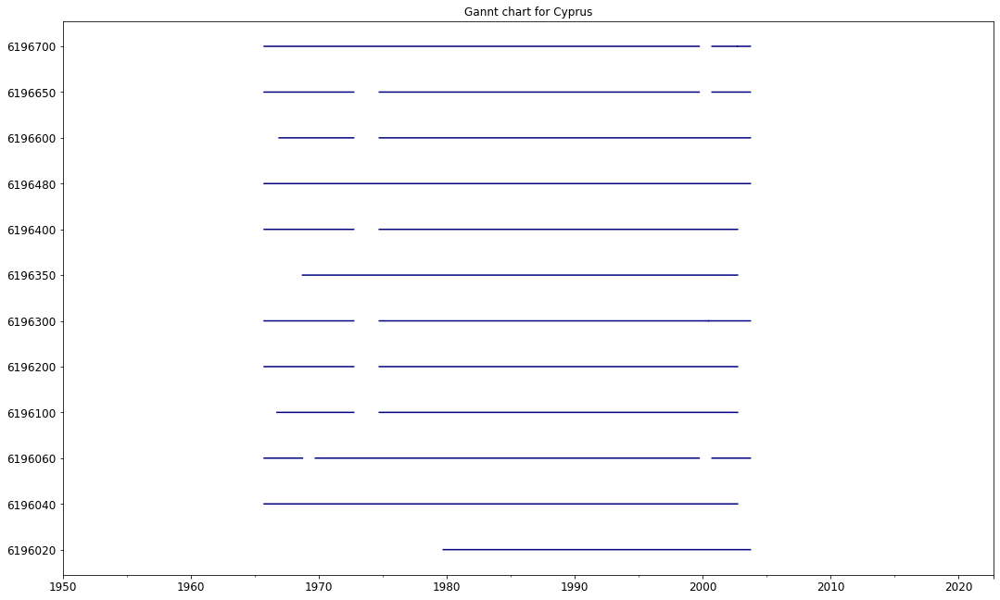

In [188]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_CY, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart for Cyprus")

In [186]:
# Here we can save our data time-series and network:
timeseries_CY.to_excel(r'GRDC\timeseries\countries\timeseries_CY.xlsx') 
network_CY.to_excel(r'GRDC\timeseries\countries\network_CY.xlsx') 

#### 12. France (FR):


In [20]:
summarygapsstations_FR, timeseries_FR, network_FR = extract_data_grdc(timeseries_GRDC = timeseriesfinal_used, summarygapsstations = summarygapsstations
                                                                      , country_code = "FR", gaps_perc = 50.0)

In [21]:
summarygapsstations_FR

,CoordX,CoordY,NumGaps,PercentageGaps,geometry,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,,
6118130,-4.362693,48.530410,2412.0,17.378774,POINT (-4.36269 48.53041),FR,24.0,90.60,6180,ABER VRAC'H,DRENNEC,1966-01-01,2012-01-01
6118150,-4.077011,48.615037,2399.0,17.285107,POINT (-4.07701 48.61504),FR,43.0,91.10,6180,GUILLEC,TREZILIDE,1966-01-01,2012-01-01
6118160,-3.924127,48.584822,2408.0,17.349953,POINT (-3.92413 48.58482),FR,141.0,61.97,6180,PENZE,TAULE (PENHOAT),1967-01-01,2012-01-01
6118165,0.580580,48.747942,3486.0,25.117083,POINT (0.58058 48.74794),FR,149.0,255.45,6180,RISLE,RAI,1965-01-01,2012-01-01
6118175,-3.800485,48.565562,2578.0,18.574825,POINT (-3.80049 48.56556),FR,44.0,73.86,6180,JARLOT,PLOUGONVEN,1966-01-01,2012-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6139960,6.270442,46.149704,3288.0,23.690468,POINT (6.27044 46.14970),FR,1664.0,458.98,6391,ARVE,ARTHAZ-PONT-NOTRE-DAME,1961-01-01,2009-01-01
6150300,9.379366,42.602313,4172.0,30.059803,POINT (9.37937 42.60231),FR,NaN,261.37,6500,BEVINCO,OLMETA-DI-TUDA (LANCONE),1960-01-01,2008-01-01
6150400,9.075456,41.724916,2412.0,17.378774,POINT (9.07546 41.72492),FR,130.0,354.42,6500,U RIZZANESE,ZOZA,1969-01-01,2012-01-01


In [22]:
timeseries_FR

,6118130,6118150,6118160,6118165,6118175,6118185,6118195,6118205,6118230,6119010,...,6139910,6139920,6139921,6139930,6139935,6139940,6139960,6150300,6150400,6150500
1950-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,87.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,79.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1950-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,62.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-09-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
network_FR

,CoordX,CoordY,NumGaps,PercentageGaps,geometry,Country,area,elevation,sub_reg,river,station,d_start,d_end
Code,,,,,,,,,,,,,
6118130,-4.362693,48.530410,2412.0,17.378774,POINT (-4.36269 48.53041),FR,24.0,90.60,6180,ABER VRAC'H,DRENNEC,1966-01-01,2012-01-01
6118150,-4.077011,48.615037,2399.0,17.285107,POINT (-4.07701 48.61504),FR,43.0,91.10,6180,GUILLEC,TREZILIDE,1966-01-01,2012-01-01
6118160,-3.924127,48.584822,2408.0,17.349953,POINT (-3.92413 48.58482),FR,141.0,61.97,6180,PENZE,TAULE (PENHOAT),1967-01-01,2012-01-01
6118165,0.580580,48.747942,3486.0,25.117083,POINT (0.58058 48.74794),FR,149.0,255.45,6180,RISLE,RAI,1965-01-01,2012-01-01
6118175,-3.800485,48.565562,2578.0,18.574825,POINT (-3.80049 48.56556),FR,44.0,73.86,6180,JARLOT,PLOUGONVEN,1966-01-01,2012-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6139940,4.648328,46.403242,2398.0,17.277902,POINT (4.64833 46.40324),FR,332.0,294.26,6391,GROSNE,JALOGNY (CLUNY),1968-01-01,2012-01-01
6139960,6.270442,46.149704,3288.0,23.690468,POINT (6.27044 46.14970),FR,1664.0,458.98,6391,ARVE,ARTHAZ-PONT-NOTRE-DAME,1961-01-01,2009-01-01
6150300,9.379366,42.602313,4172.0,30.059803,POINT (9.37937 42.60231),FR,NaN,261.37,6500,BEVINCO,OLMETA-DI-TUDA (LANCONE),1960-01-01,2008-01-01


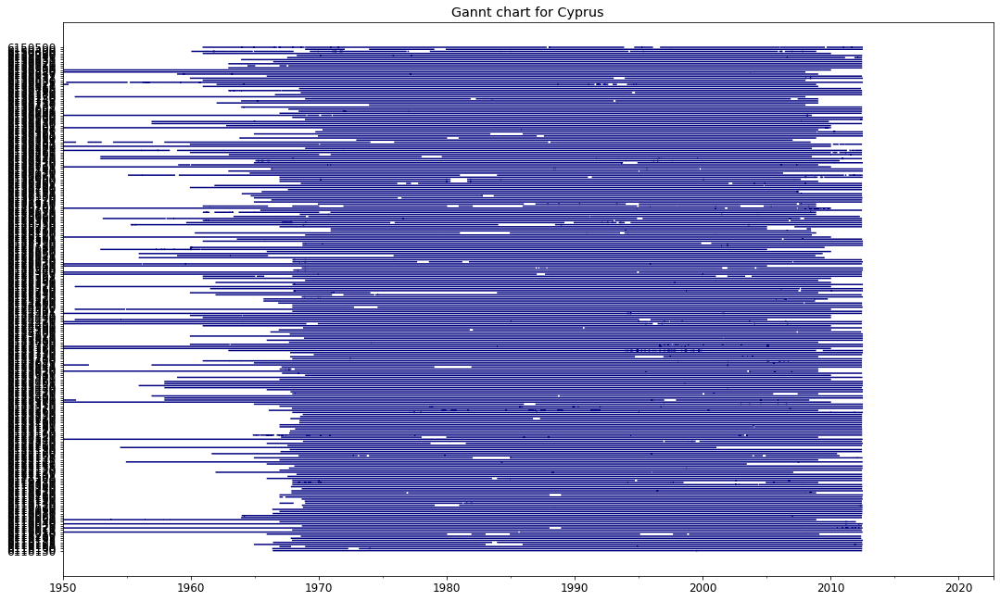

In [24]:
figplot, axesplot = geospatialfunctions.plotganntchart(timeseriesfinal_gantt = timeseries_FR, 
                                                       
                                                       figsize_chart = (18, 11), showcodes = True,
                                                       color_chart = "navy", fontsize_chart = 12,facecolor_chart = "white", 
                                                       title_chart = "Gannt chart")

In [ ]:
geospatialfunctions.plotgapsmap(summarygapsstations = summarygapsstations_CY, crsproj = 'epsg:4326', backmapproj = True, 
                             figsizeproj = (15, 30), cmapproj = "Reds", markersize_map = 100)